<div class="alert-danger"><center> <h1> Exploration of Healthcare Accessibility in Los Angeles County, California
 </div>

In [6]:
# the usuals
import geopandas as gpd
import matplotlib.pyplot as plt
import pandas as pd
import contextily as ctx
from sodapy import Socrata
import numpy as np
# new for data viz
import seaborn as sns

# to explore point patterns
from pointpats import centrography
from matplotlib.patches import Ellipse
import numpy

import pandas as pd
from geopandas import GeoDataFrame

import osmnx as ox
import folium


/opt/conda/lib/python3.8/site-packages/geopandas/_compat.py:106: UserWarning: The Shapely GEOS version (3.8.1-CAPI-1.13.3) is incompatible with the GEOS version PyGEOS was compiled with (3.9.0-CAPI-1.16.2). Conversions between both will be slow.
  warnings.warn(


<div class="alert-info"> <h1> Centrography analysis </div>

In [12]:
hc = gpd.read_file('flac.geojson')

In [13]:
hc=hc[['LICENSED_CERTIFIED','CITY','FAC_FDR','ADDRESS','geometry']]

In [14]:
hc.columns = ['Licensed_certified_both','City','Type_of_Care','Address','geometry']

In [15]:
hc['x'] = hc.geometry.x
hc['y'] = hc.geometry.y

In [16]:
mean_center = centrography.mean_center(hc[['x','y']])
med_center = centrography.euclidean_median(hc[['x','y']])

In [17]:
#Located in Los Feliz, zip code 90027, coordinates 34° 6' 38.3826", -118° 17' 25.7244"
mean_center

array([-118.29047904,   34.11066239])

In [18]:
#Located in Hollywoodland, zip code 90068, coordinates 34° 7' 20.4882",  -118° 18' 43.8942" 
med_center

array([-118.31219315,   34.12235846])

<IPython.core.display.Javascript object>


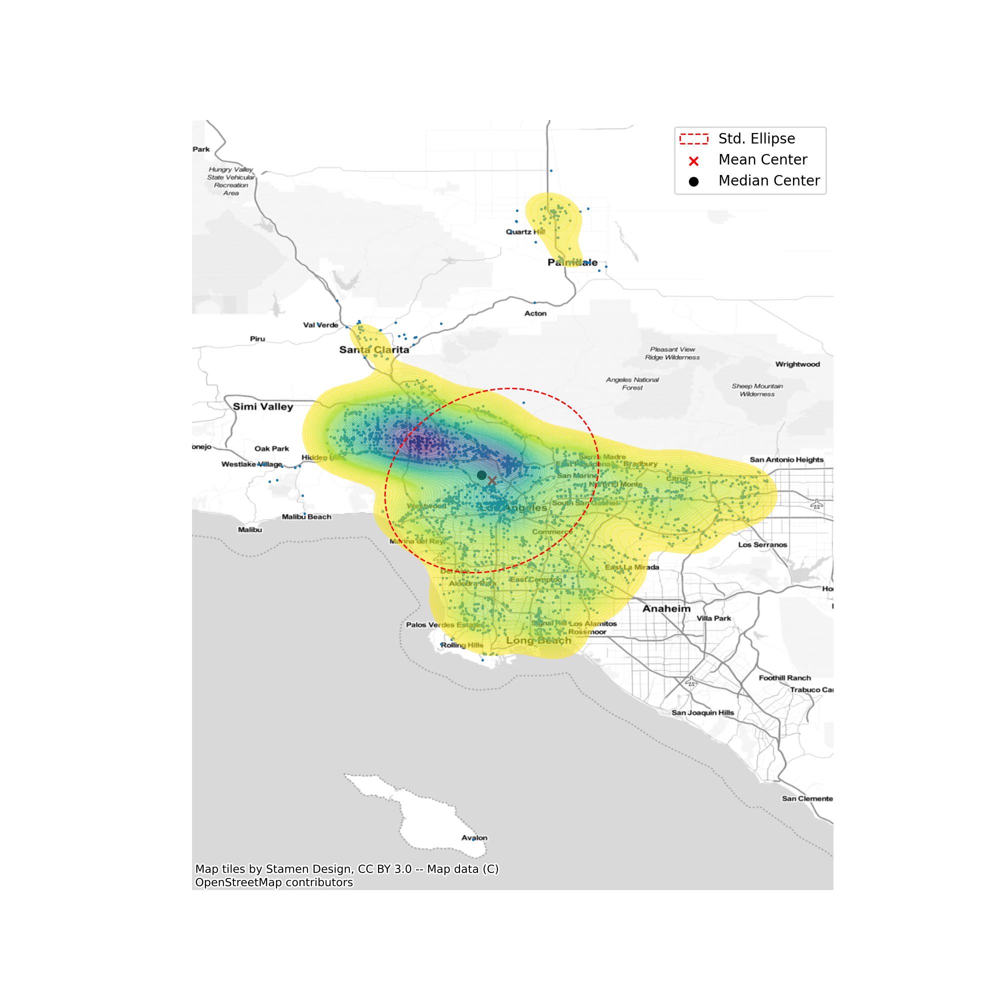

/opt/conda/lib/python3.8/site-packages/seaborn/_decorators.py:36: FutureWarning: Pass the following variable as a keyword arg: y. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  warnings.warn(


In [19]:
%matplotlib nbagg
major, minor, rotation = centrography.ellipse(hc[['x','y']])

f, ax = plt.subplots(1, figsize=(10, 10))

ax.scatter(hc['x'], hc['y'], s=0.75)
ax.scatter(*mean_center, color='red', marker='x', label='Mean Center')
ax.scatter(*med_center, color='black', marker='o', label='Median Center')

ellipse = Ellipse(xy=mean_center, 
                  width=major*2, 
                  height=minor*2, 
                  angle = numpy.rad2deg(rotation), 
                  facecolor='none', 
                  edgecolor='red', 
                  linestyle='--',
                  label='Std. Ellipse')

ax.add_patch(ellipse)

ax.legend()

ax.axis('off')

sns.kdeplot(
    hc['x'], 
    hc['y'],
    n_levels=60, 
    shade=True,
    alpha=0.55, 
    cmap='viridis_r')
    
ctx.add_basemap(ax,
                crs='epsg:4326',
                source=ctx.providers.Stamen.TonerLite)

plt.show()
plt.savefig("centrography.jpg")

<div class="alert-info"> <h1> Five areas with the largest count of healthcare facilities </div>

In [10]:
def acc(City, Type_of_Care):
    
    # filter the data by type of care
    hc_filtered = hc[(hc.Type_of_Care == Type_of_Care) & (hc.City == City)]

    # mean center and median
    mean_center = centrography.mean_center(hc_filtered[['x','y']])
    med_center = centrography.euclidean_median(hc_filtered[['x','y']])

    # standard ellipse
    major, minor, rotation = centrography.ellipse(hc_filtered[['x','y']])

    # Set up figure and axis
    f, ax = plt.subplots(1, figsize=(9, 9))

    # plot facilities points
    ax.scatter(hc_filtered['x'], hc_filtered['y'], s=3)

    # add the mean and median center points
    ax.scatter(*mean_center, color='red', marker='x', label='Mean Center')
    ax.scatter(*med_center, color='limegreen', marker='o', label='Median Center')
    print(mean_center)
    print(med_center)

    # Construct the standard ellipse using matplotlib
    ellipse = Ellipse(xy=mean_center, # center the ellipse on our mean center
                      width=major*2, # centrography.ellipse db_filtered
                      height=minor*2, 
                      angle = numpy.rad2deg(rotation), # Angles for this are in degrees, not radians
                      facecolor='none', 
                      edgecolor='red', linestyle='--',
                      label='Std. Ellipse')

    ax.add_patch(ellipse)

    # add the legend
    ax.legend()

    # no axix
    ax.axis('Off')

    # add a dynamic title
    ax.set_title(City + ': ' + str(len(hc_filtered))+ ' ' + Type_of_Care + ' facilities')

    # add a basemap
    ctx.add_basemap(ax,
                    crs='epsg:4326',
                    source=ctx.providers.Stamen.TonerLite)
    # Display
    plt.show()

In [11]:
top5areas = hc['City'].value_counts().head(5).index.tolist()
top5areas

['LOS ANGELES', 'VAN NUYS', 'GLENDALE', 'BURBANK', 'NORTH HOLLYWOOD']

In [12]:
top3hc = hc['Type_of_Care'].value_counts().head(3).index.tolist()
top3hc

['HOME HEALTH AGENCY', 'HOSPICE', 'PRIMARY CARE CLINIC']

<IPython.core.display.Javascript object>


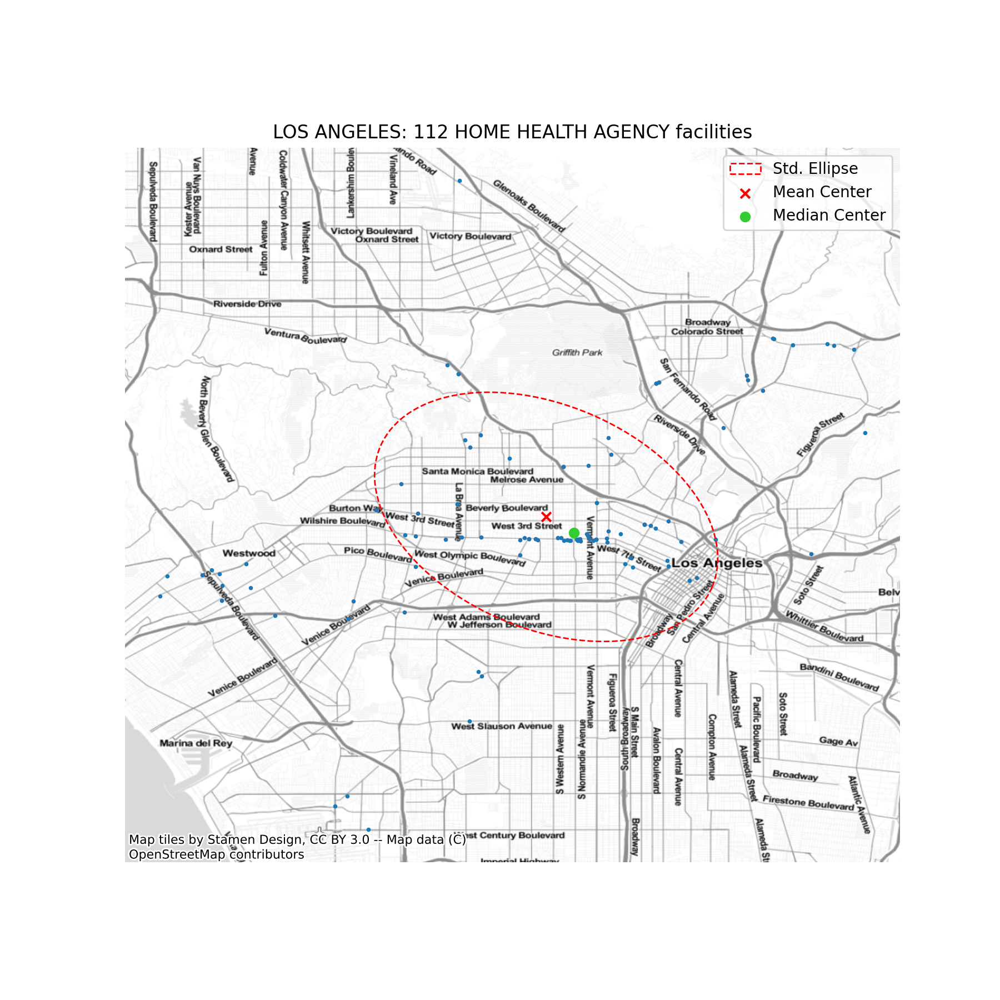

[-118.31210884   34.07063808]
[-118.30105171   34.0643662 ]


<IPython.core.display.Javascript object>


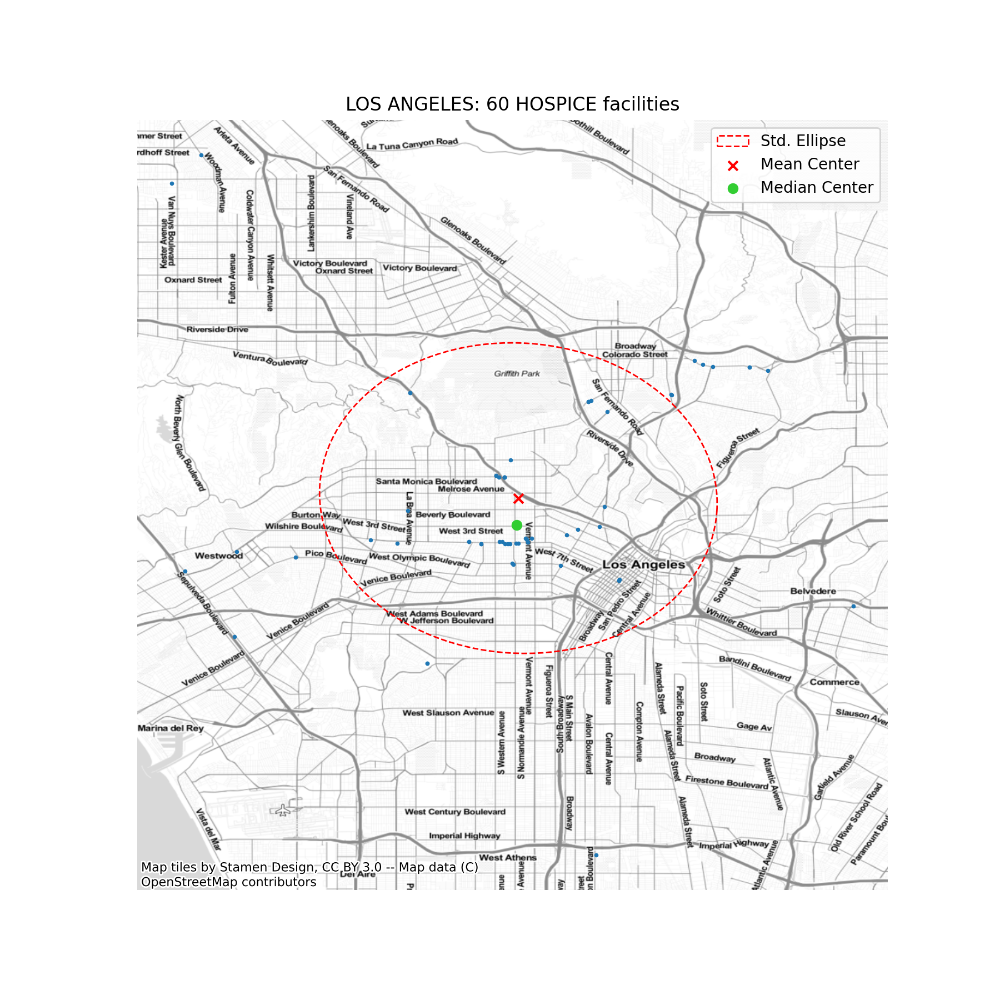

[-118.29907717   34.08146205]
[-118.29972999   34.0697192 ]


<IPython.core.display.Javascript object>


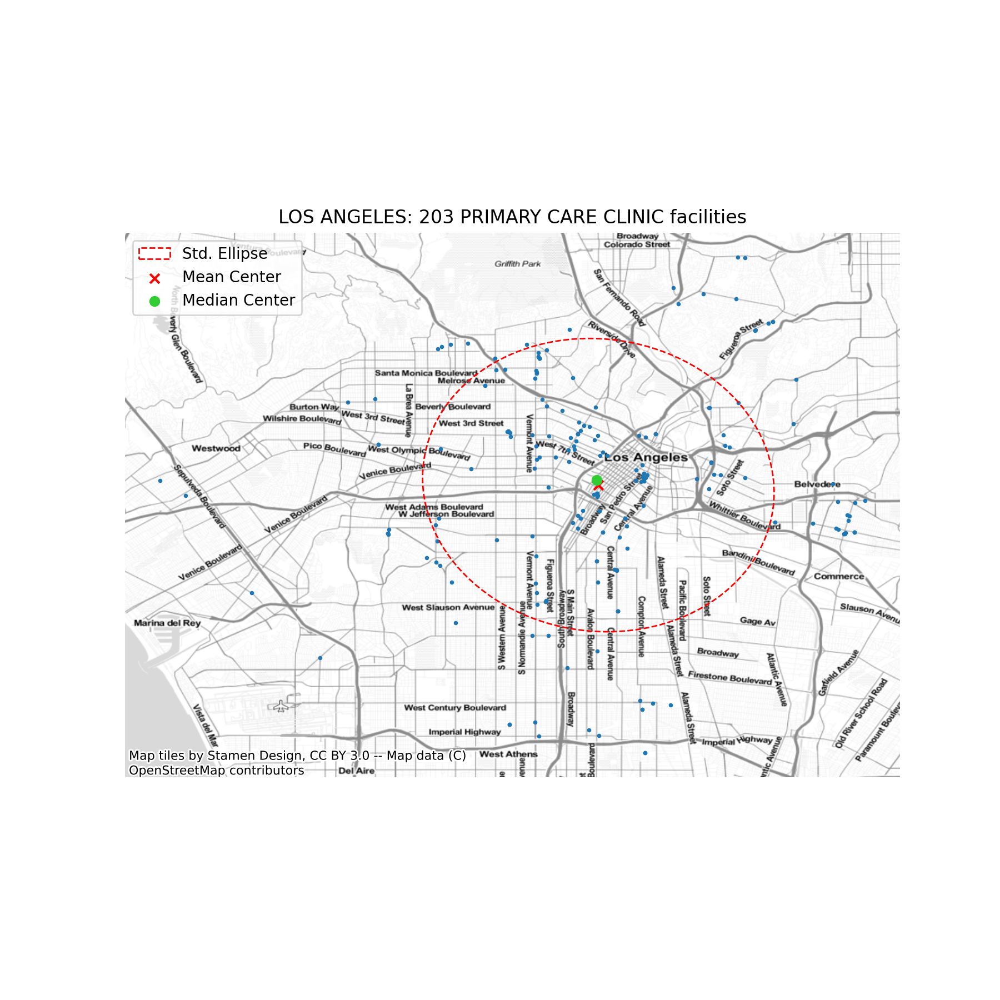

[-118.26462241   34.04030097]
[-118.26535372   34.04244837]


<IPython.core.display.Javascript object>


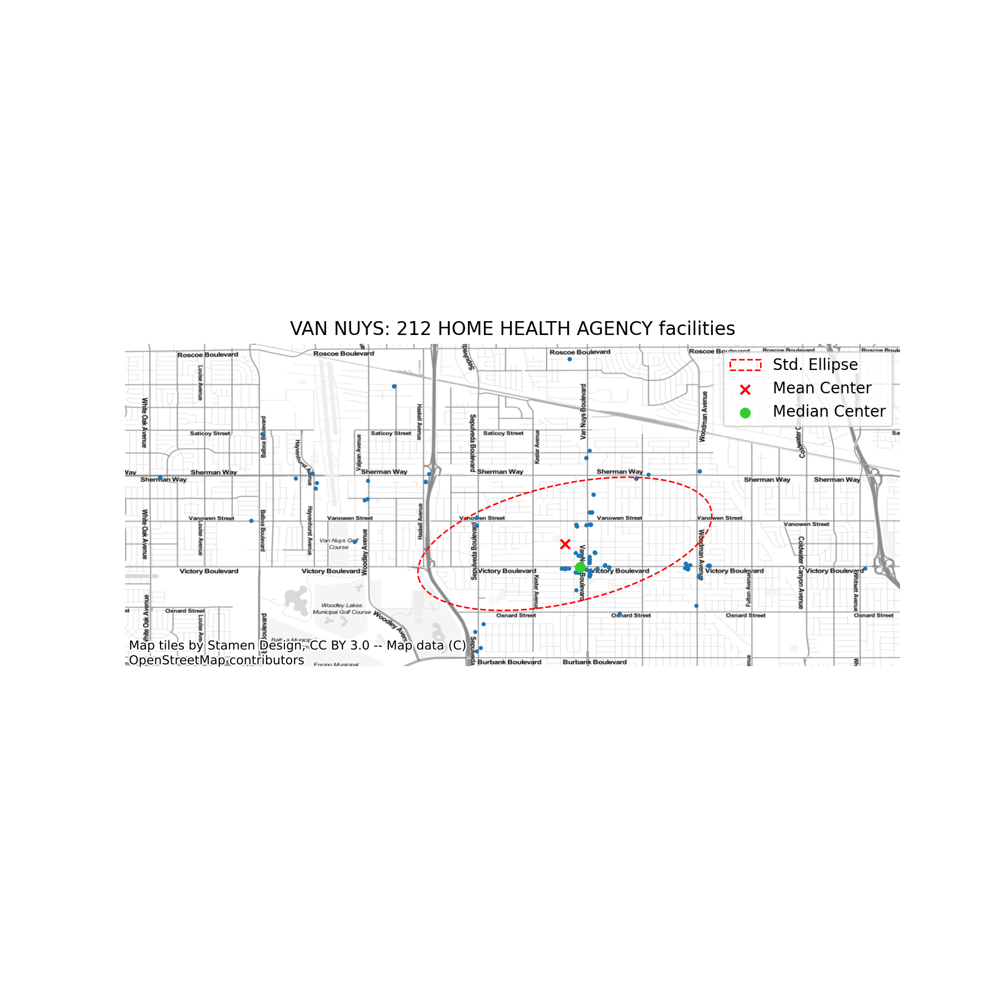

[-118.4524142    34.19031354]
[-118.45001022   34.18653993]


<IPython.core.display.Javascript object>


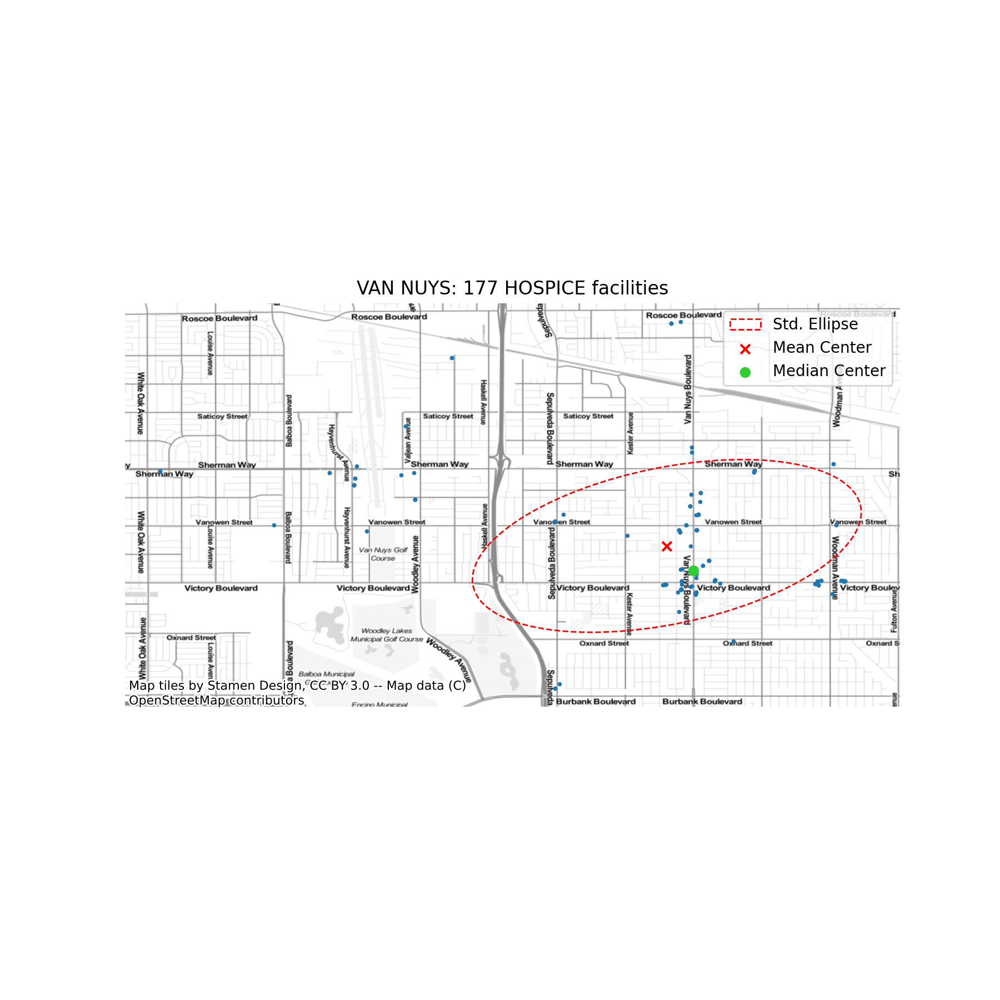

[-118.45218073   34.19136749]
[-118.44882478   34.18818568]


<IPython.core.display.Javascript object>


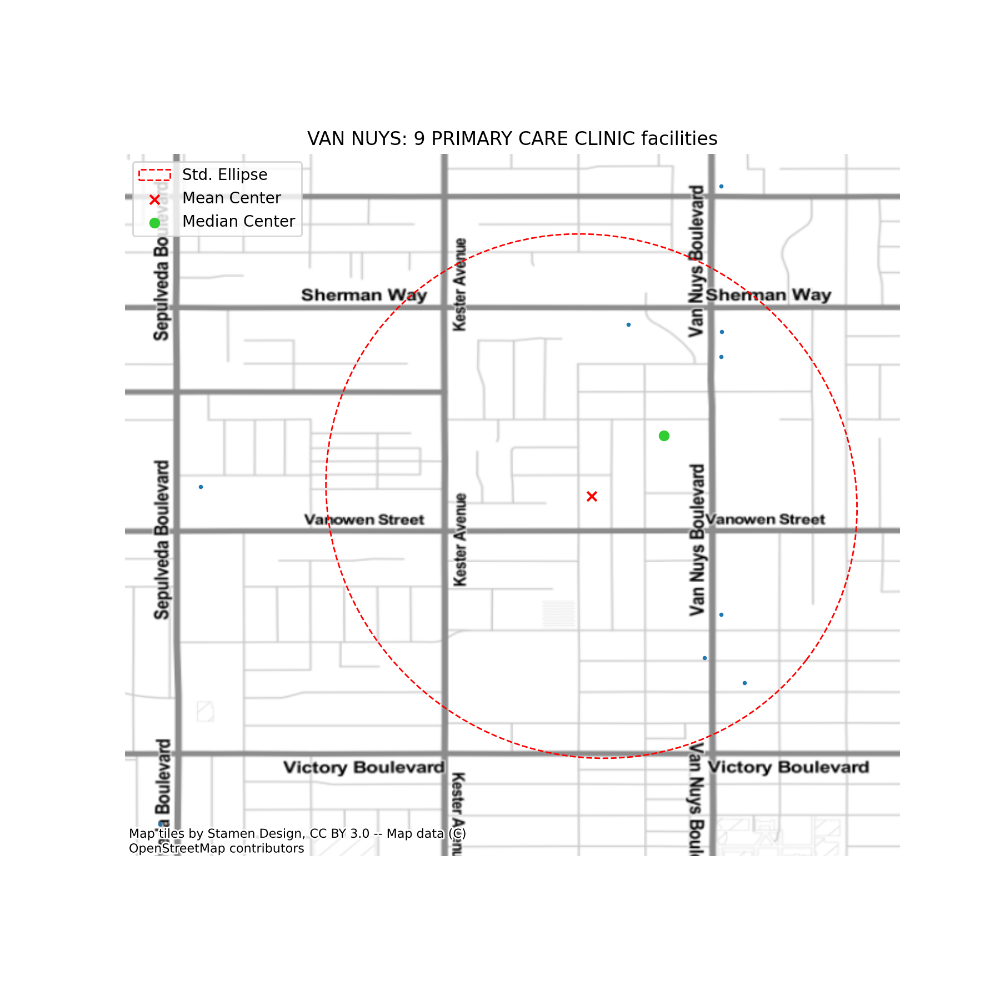

[-118.45269    34.195079]
[-118.45032654   34.19705938]


<IPython.core.display.Javascript object>


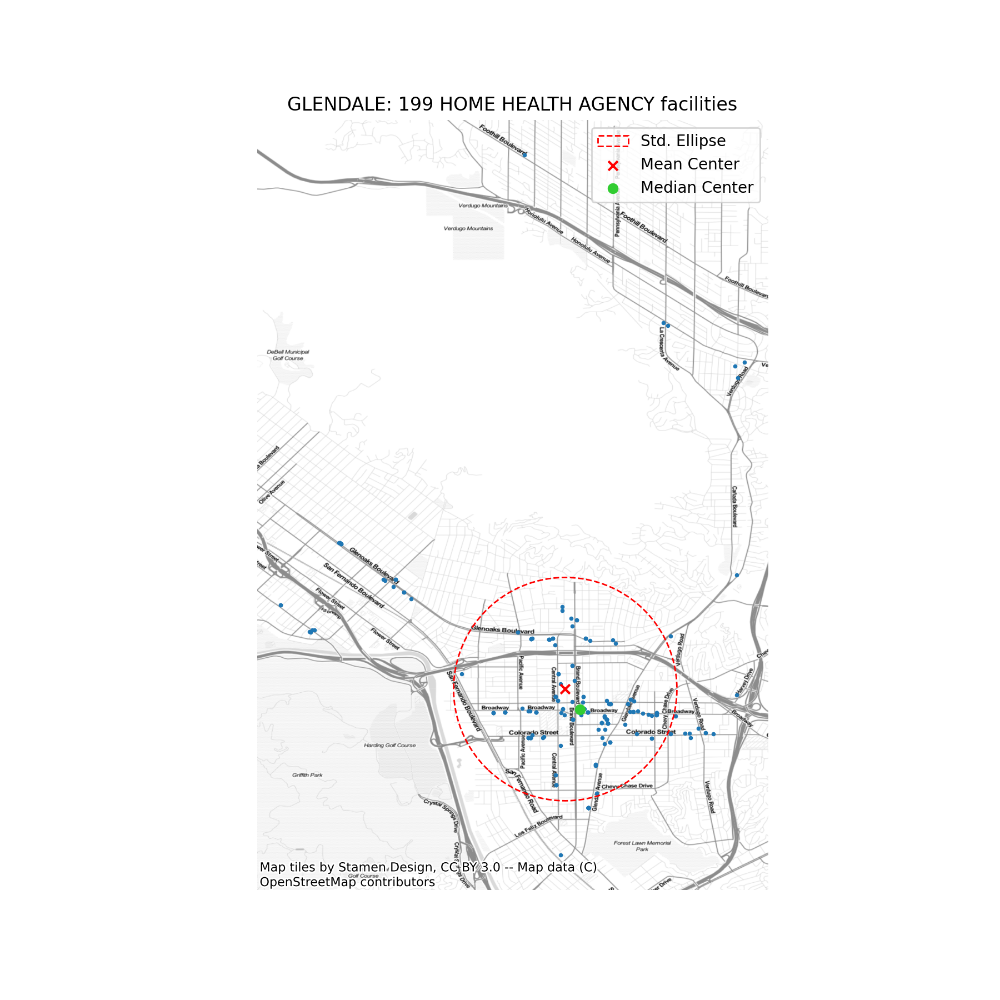

[-118.25667372   34.15037966]
[-118.25419732   34.14697744]


<IPython.core.display.Javascript object>


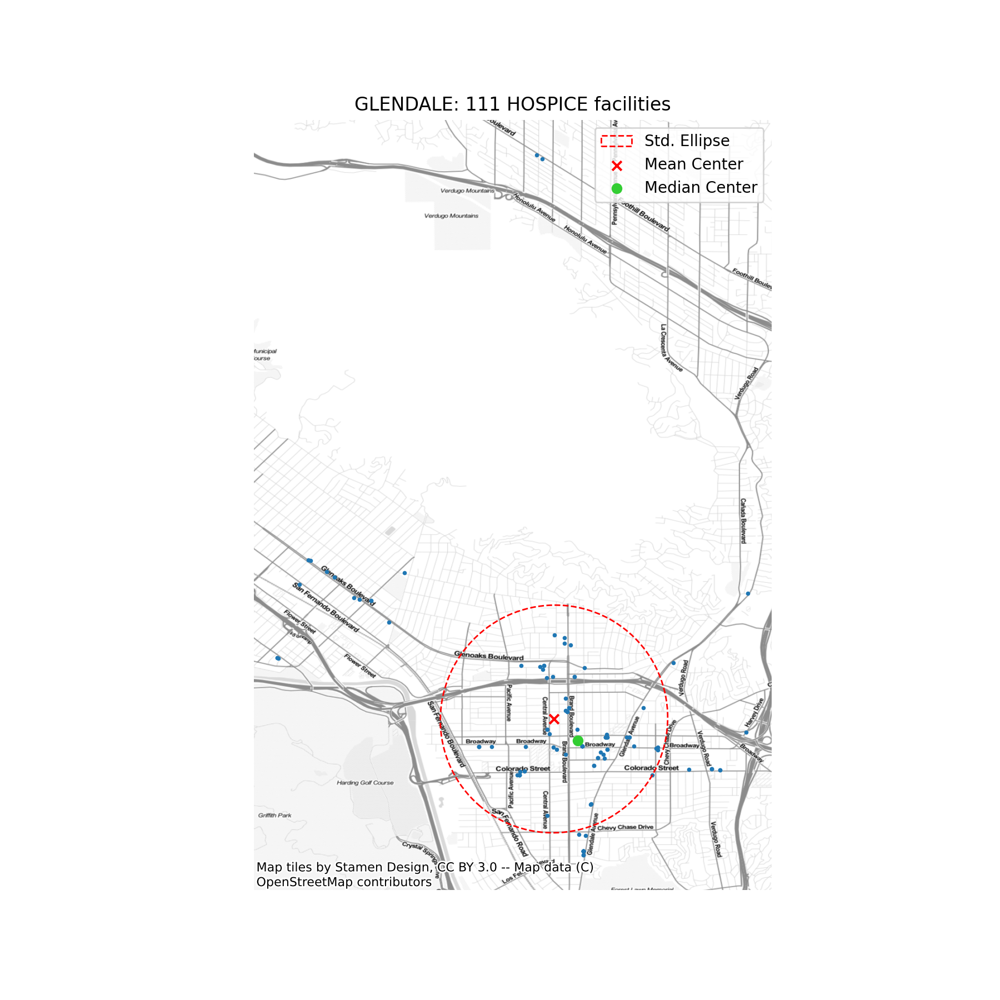

[-118.25721685   34.15069885]
[-118.25363835   34.14742404]


<IPython.core.display.Javascript object>


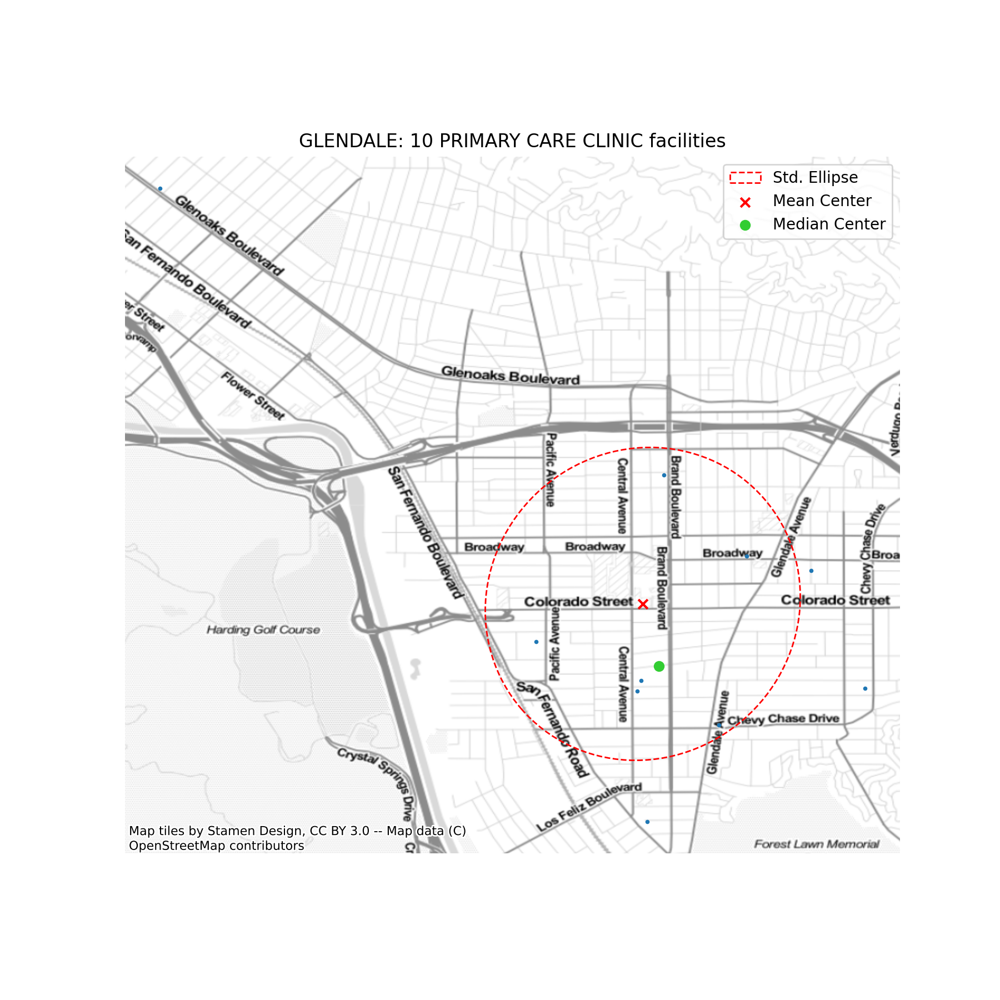

[-118.257105     34.14299879]
[-118.25587415   34.138288  ]


<IPython.core.display.Javascript object>


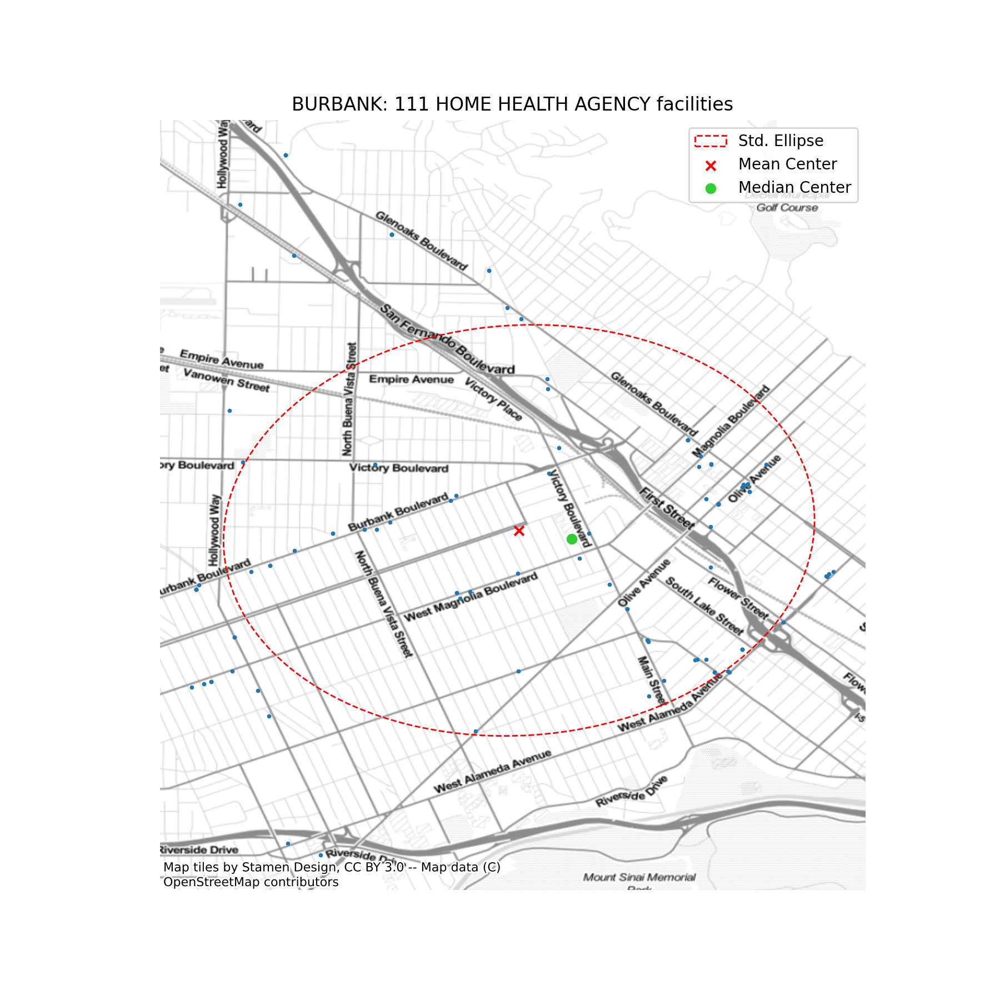

[-118.32481072   34.17892331]
[-118.32047079   34.17823287]


<IPython.core.display.Javascript object>


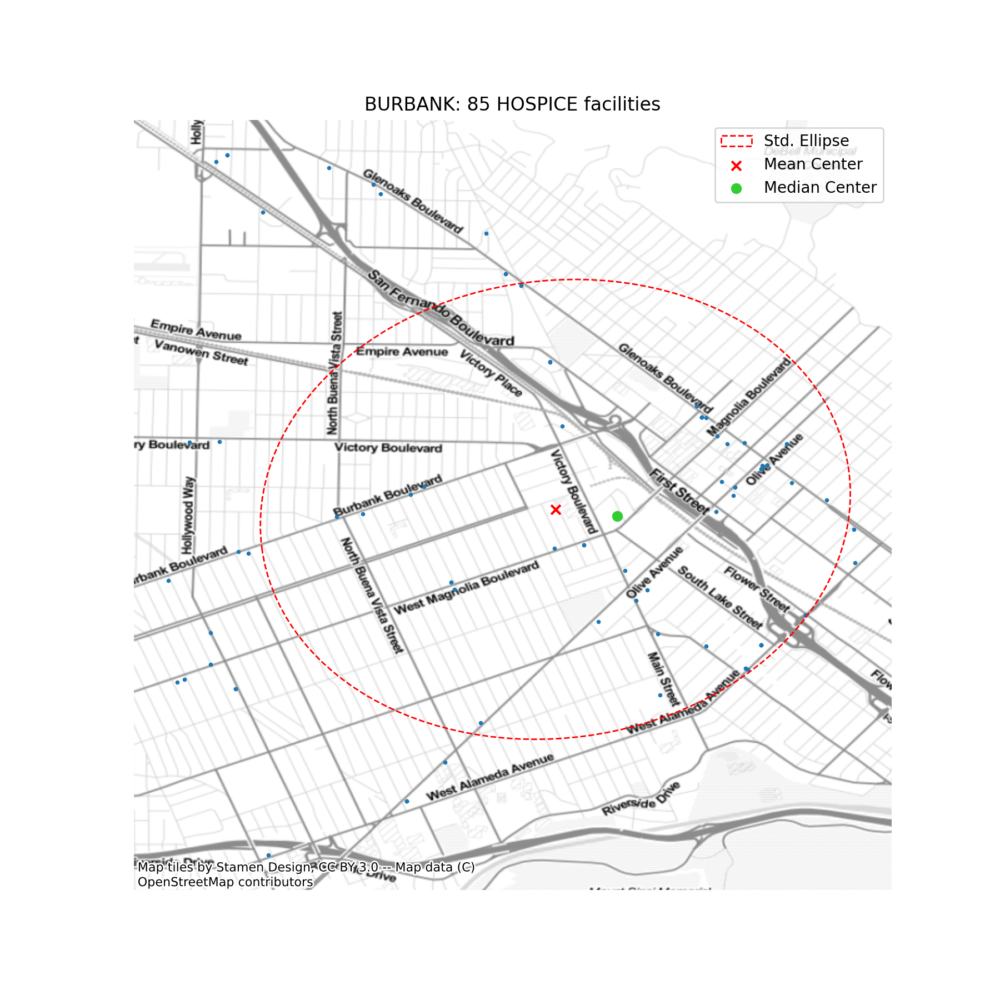

[-118.32204729   34.17938324]
[-118.31735258   34.17888286]


<IPython.core.display.Javascript object>


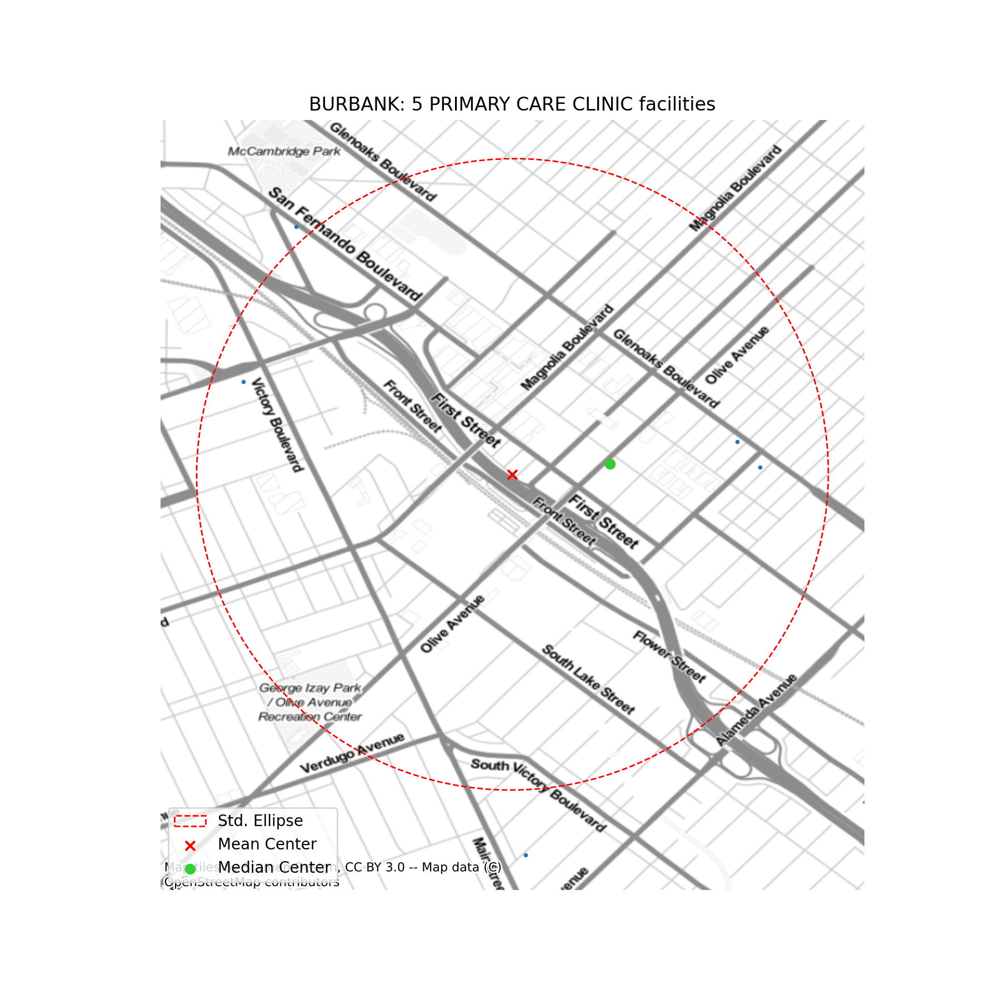

[-118.312452     34.18017802]
[-118.30884851   34.18055609]


<IPython.core.display.Javascript object>


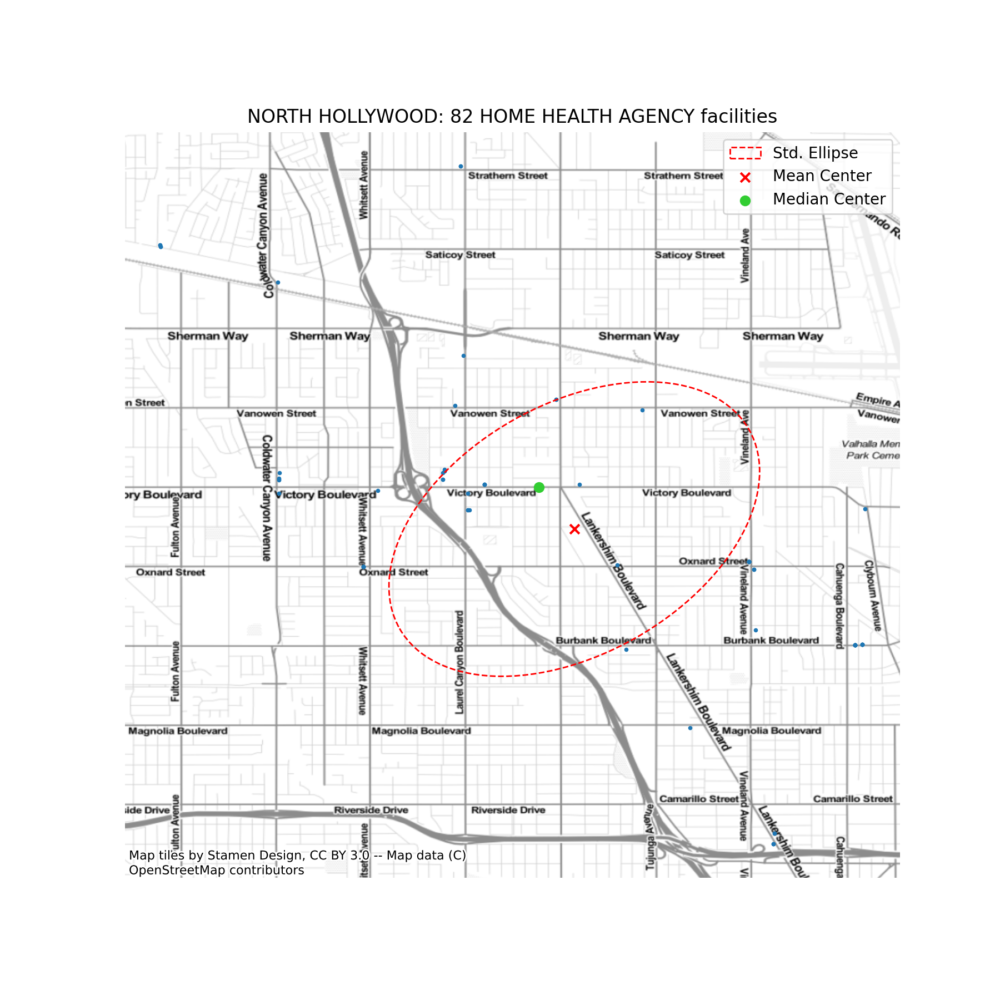

[-118.38656146   34.18289617]
[-118.38979817   34.18672808]


<IPython.core.display.Javascript object>


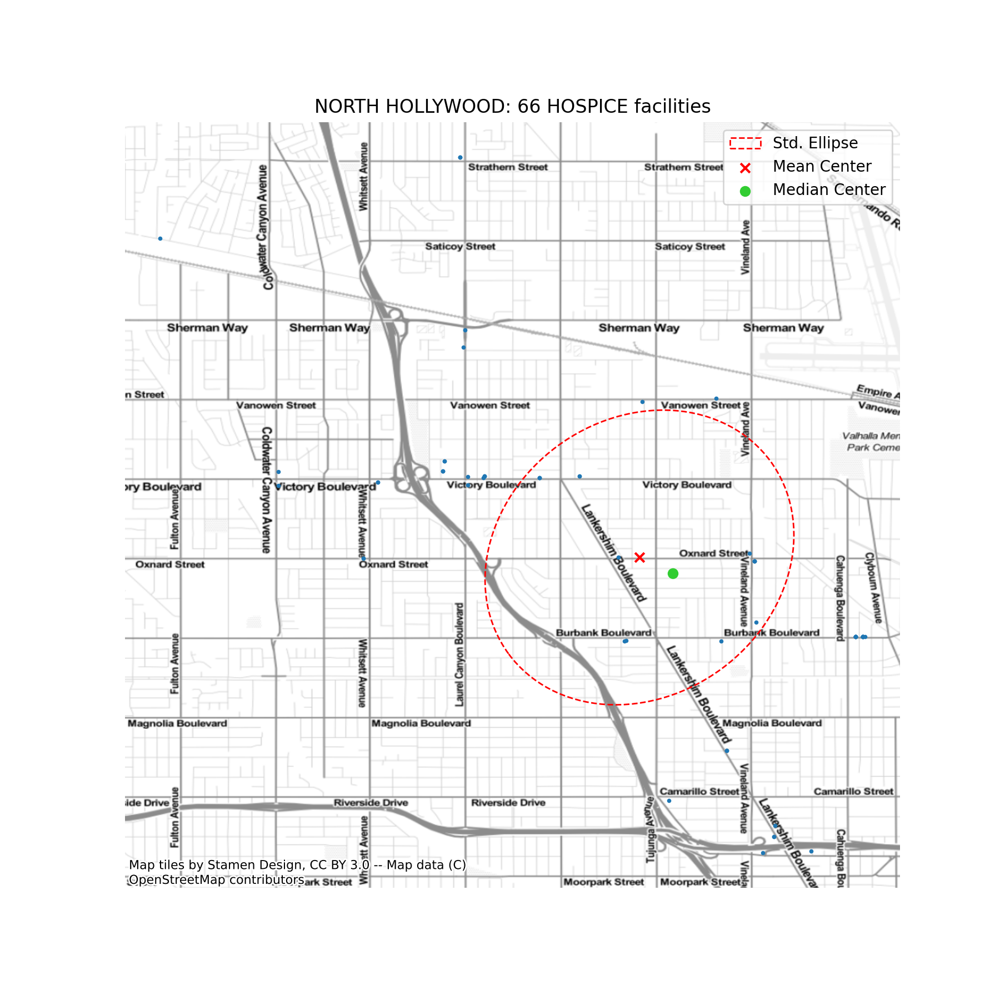

[-118.38061667   34.17955395]
[-118.37755662   34.17808434]


<IPython.core.display.Javascript object>


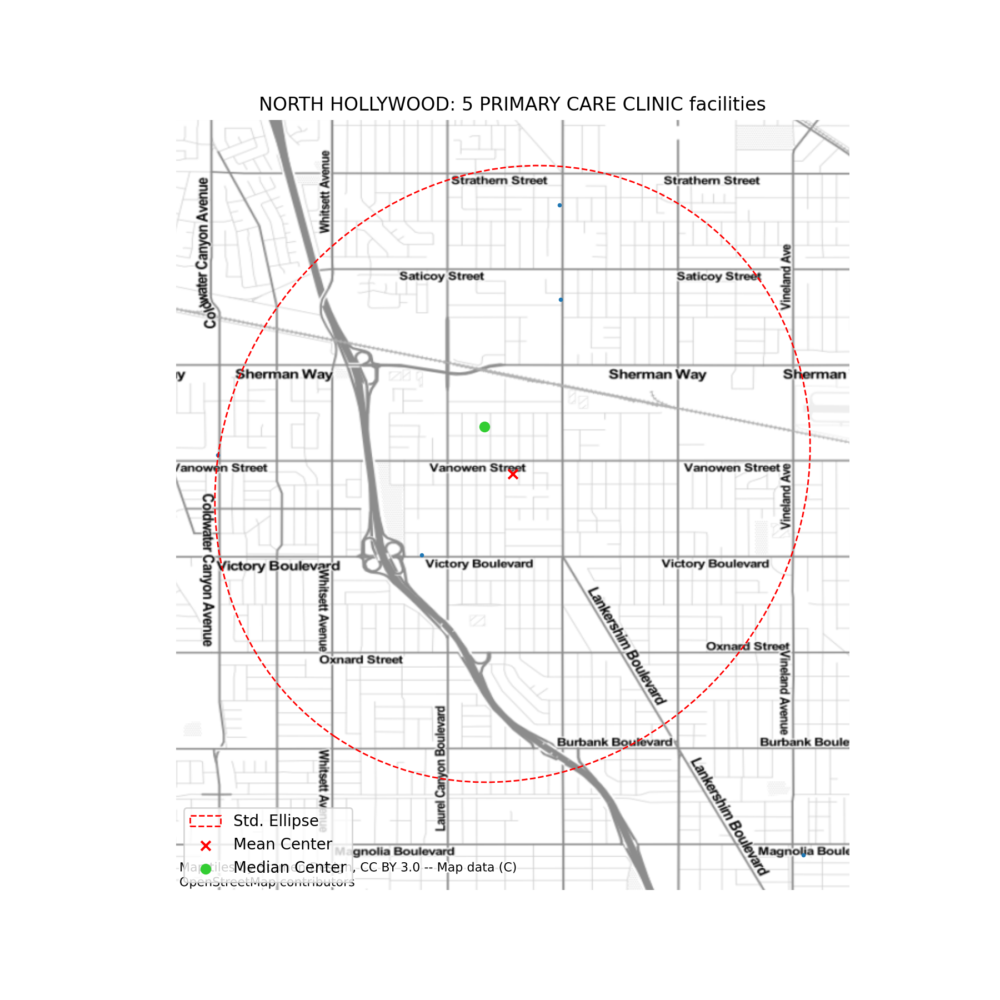

[-118.39161     34.1929944]
[-118.3937551    34.19655799]


In [13]:
for City in top5areas:
    for Type_of_Care in top3hc:
        acc(City = City, Type_of_Care = Type_of_Care)

<div class="alert-info"> <h1> Five areas with the lowest count of healthcare facilities </div>

In [14]:
bottom5areas = hc['City'].value_counts().tail(5).index.tolist()
bottom5areas

['LAKEVIEW TERRACE',
 'WEST TOLUCA LAKE',
 'EAST RNCHO DOMINGUEZ',
 'ACTON',
 'ROLLING HILLS ESTATE']

In [15]:
bottom3hc = hc['Type_of_Care'].value_counts().tail(3).index.tolist()
bottom3hc


['PEDIATRIC DAY HEALTH & RESPITE CARE FACILITY',
 'ALTERNATIVE BIRTHING CENTER',
 'INTERMEDIATE CARE FACILITY']

/opt/conda/lib/python3.8/site-packages/pointpats/centrography.py:164: RuntimeWarning: Mean of empty slice.
  return points.mean(axis=0)
/opt/conda/lib/python3.8/site-packages/numpy/core/_methods.py:162: RuntimeWarning: invalid value encountered in true_divide
  ret = um.true_divide(
/opt/conda/lib/python3.8/site-packages/pointpats/centrography.py:262: RuntimeWarning: Mean of empty slice.
  xd = x - x.mean()
/opt/conda/lib/python3.8/site-packages/numpy/core/_methods.py:170: RuntimeWarning: invalid value encountered in double_scalars
  ret = ret.dtype.type(ret / rcount)
/opt/conda/lib/python3.8/site-packages/pointpats/centrography.py:263: RuntimeWarning: Mean of empty slice.
  yd = y - y.mean()
/opt/conda/lib/python3.8/site-packages/pointpats/centrography.py:269: RuntimeWarning: invalid value encountered in double_scalars
  theta = np.arctan(num / den)


<IPython.core.display.Javascript object>


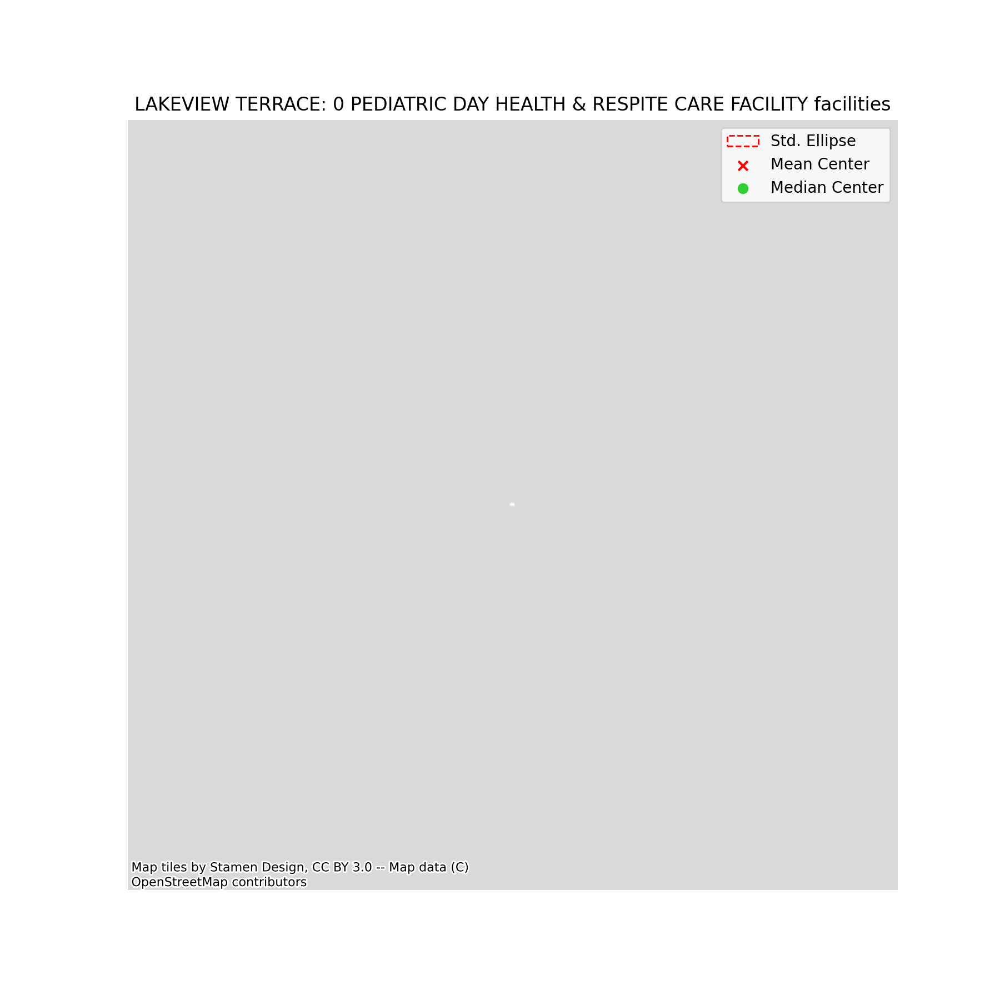

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


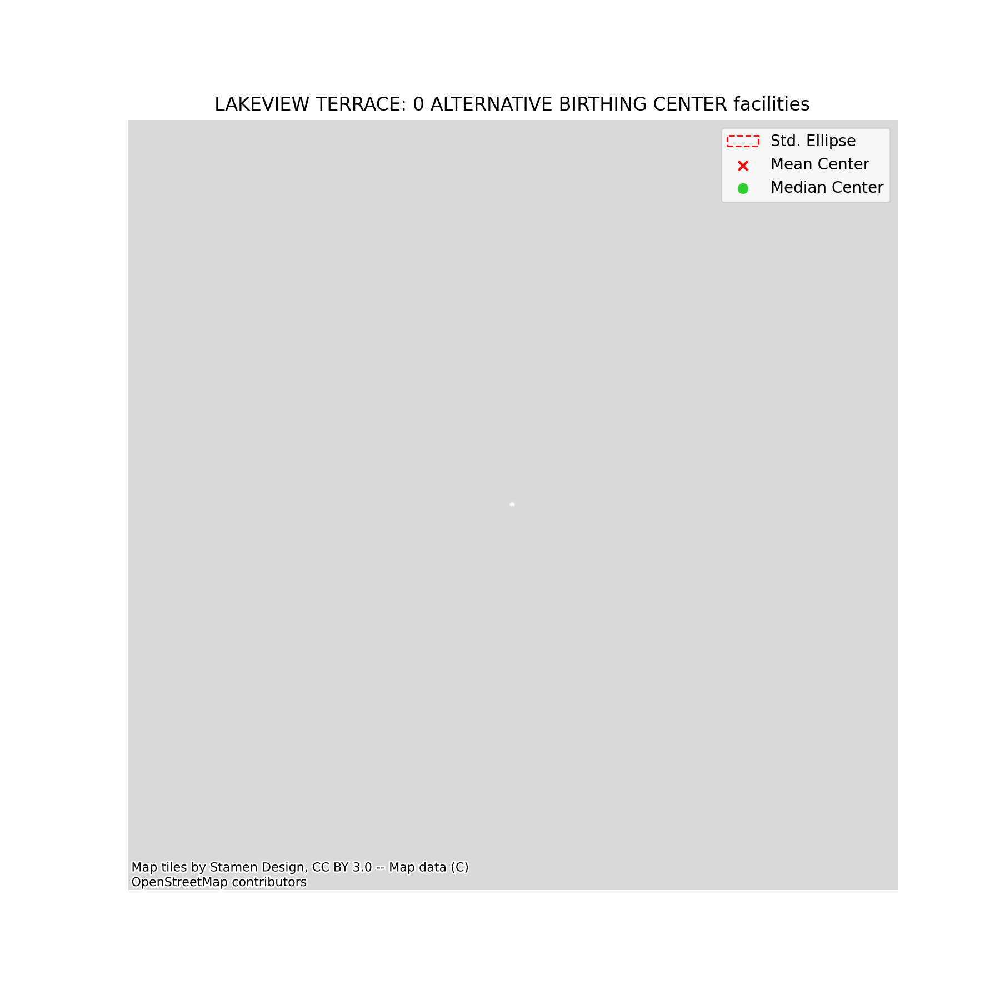

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


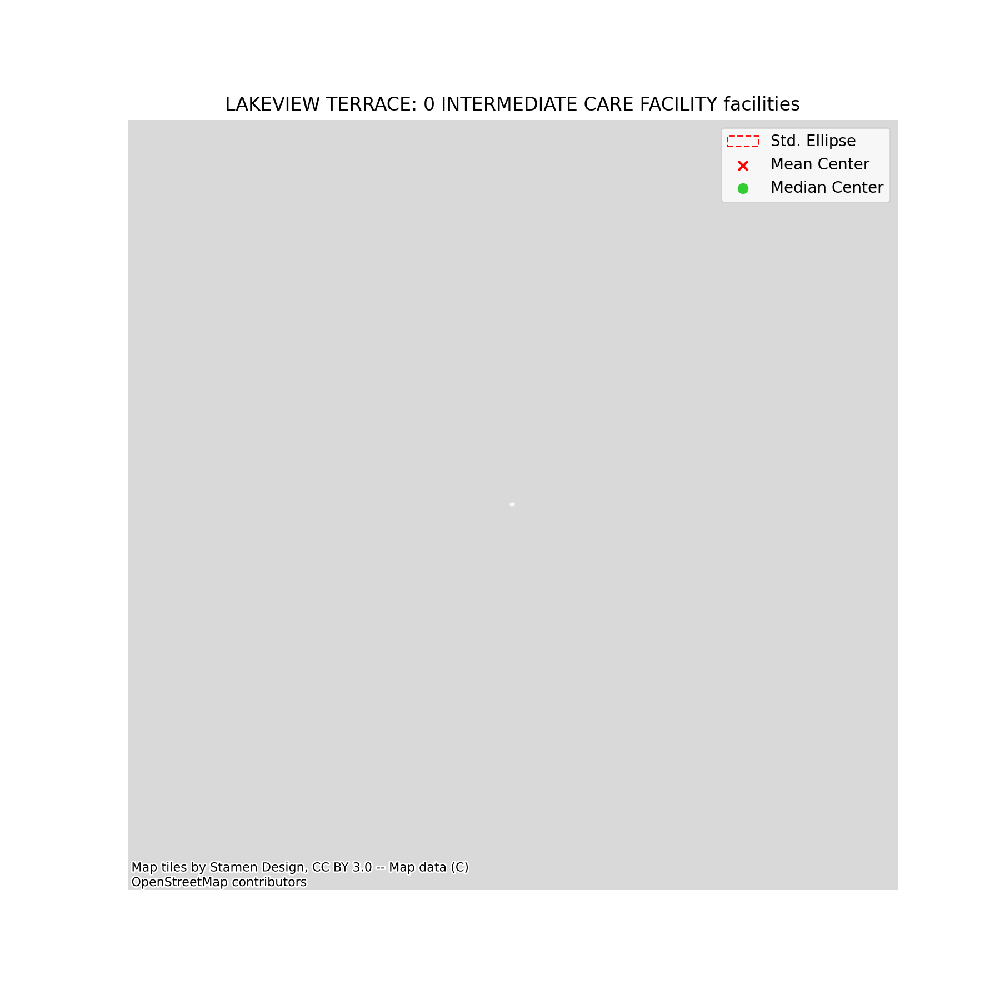

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


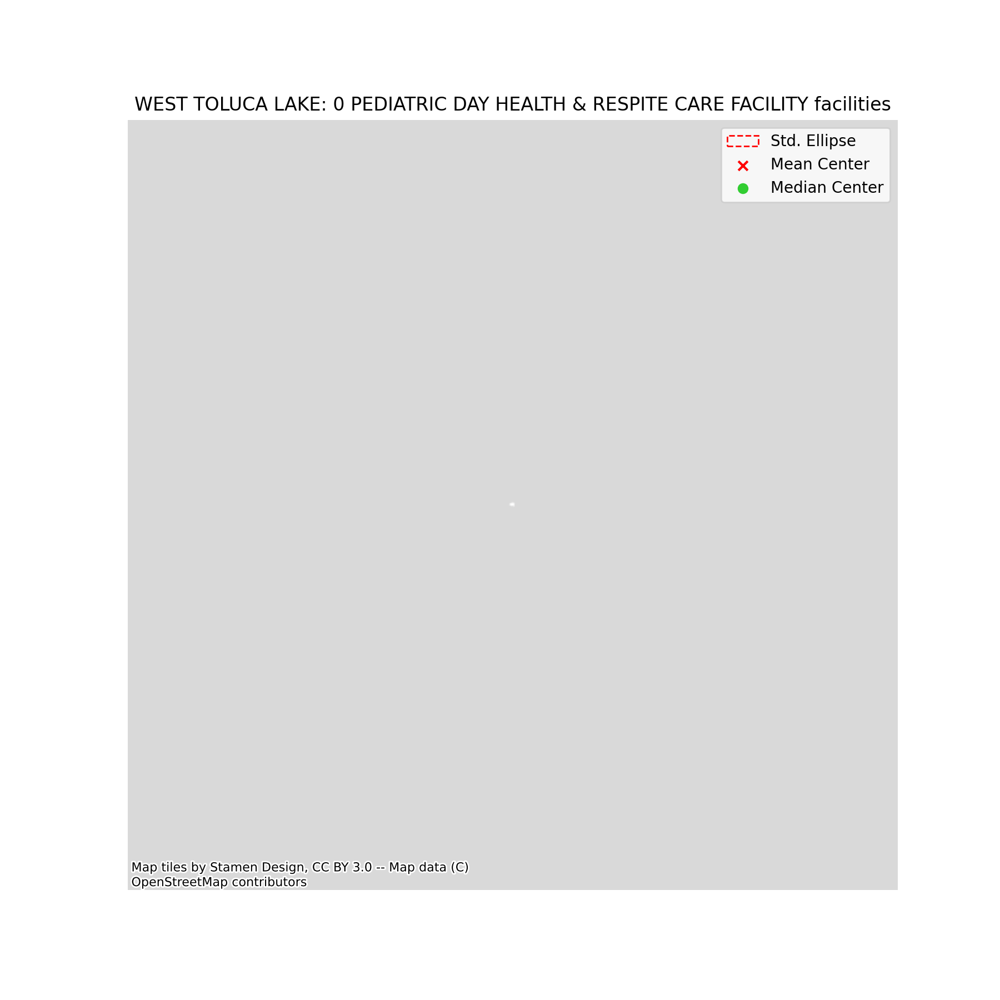

[nan nan]
[nan nan]


<ipython-input-10-2ed2df1f93df>:14: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  f, ax = plt.subplots(1, figsize=(9, 9))


<IPython.core.display.Javascript object>


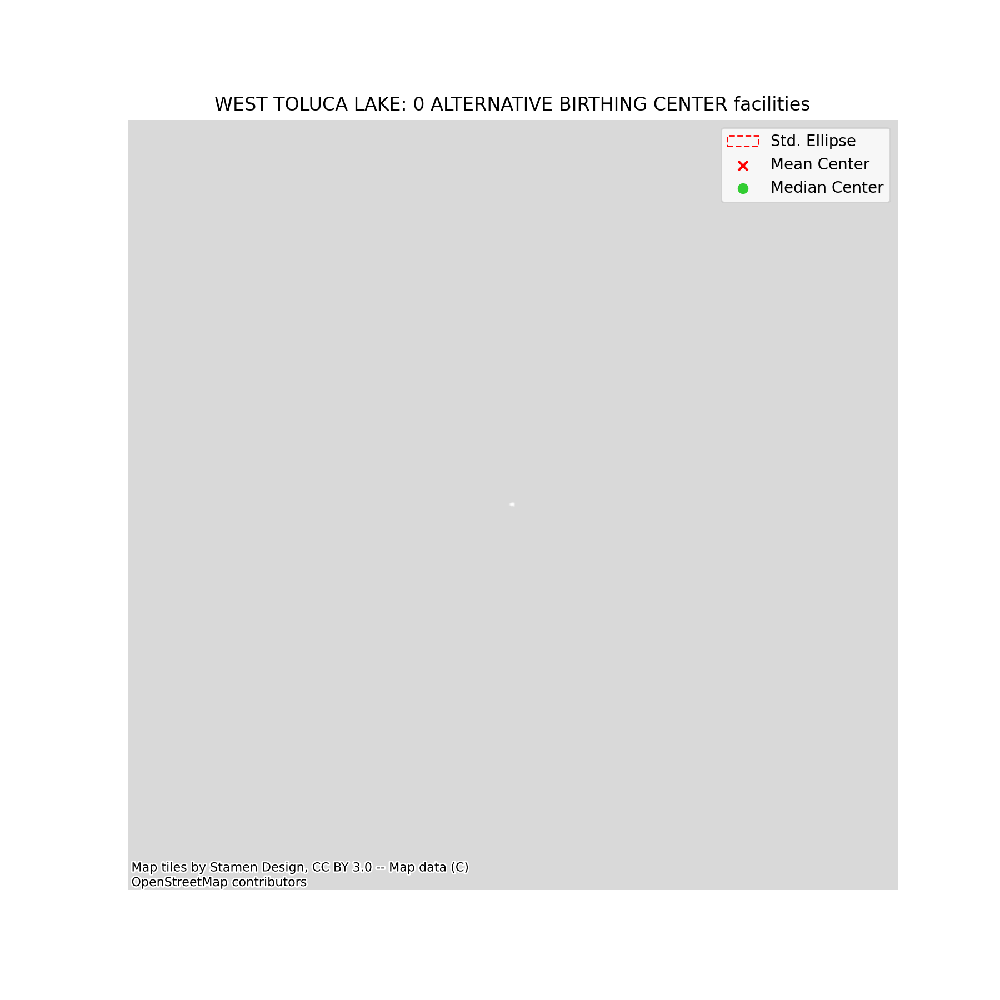

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


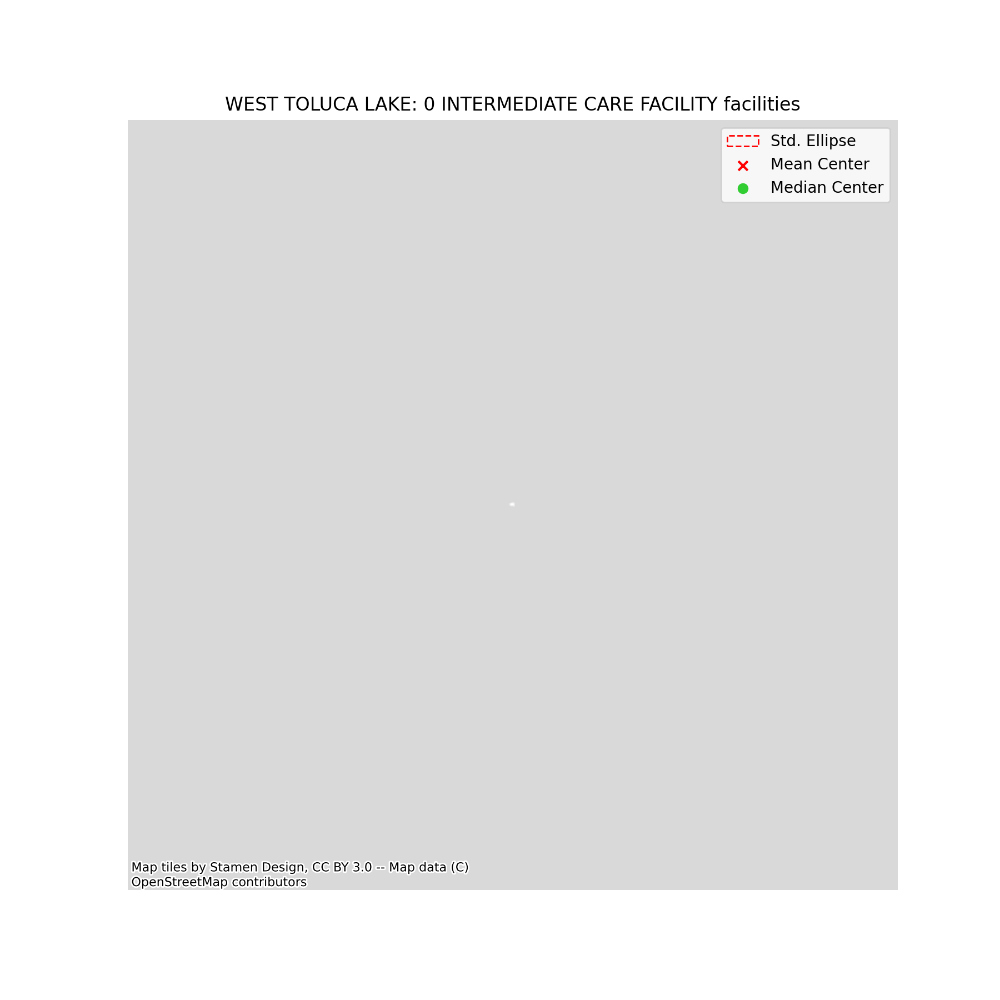

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


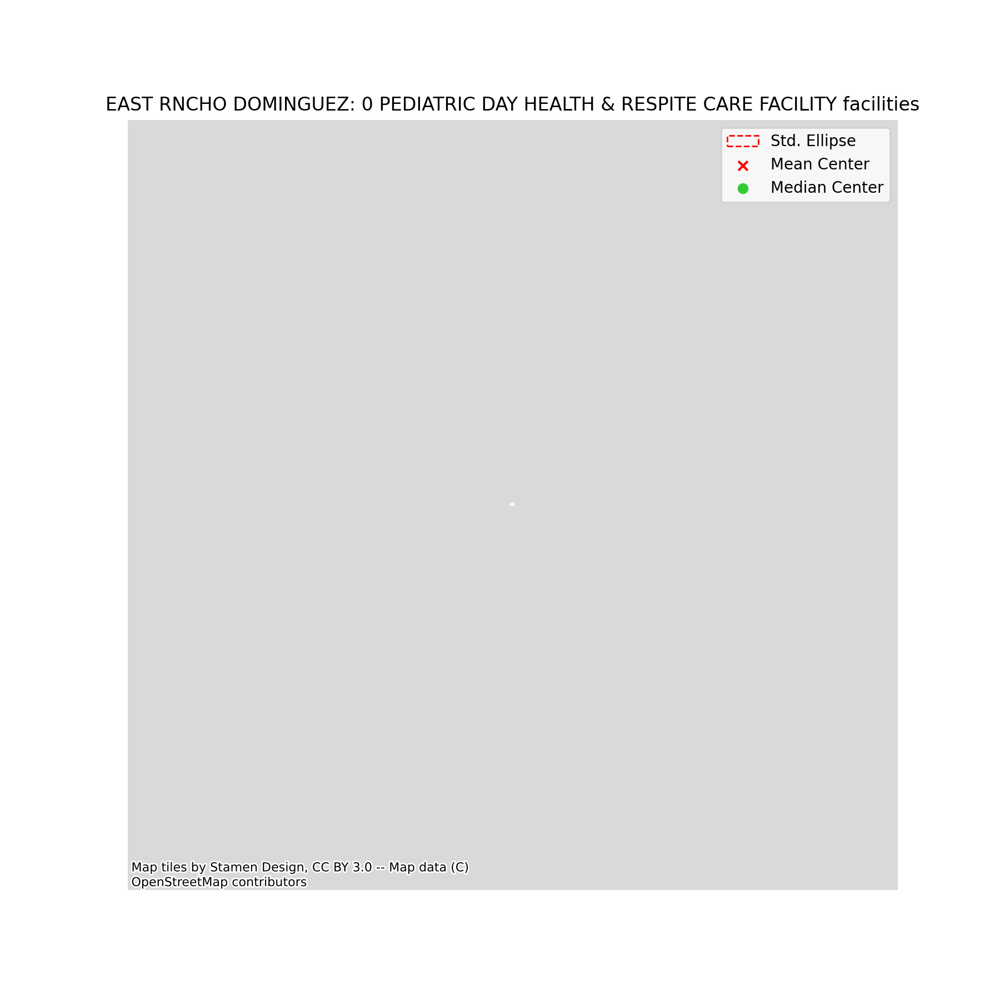

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


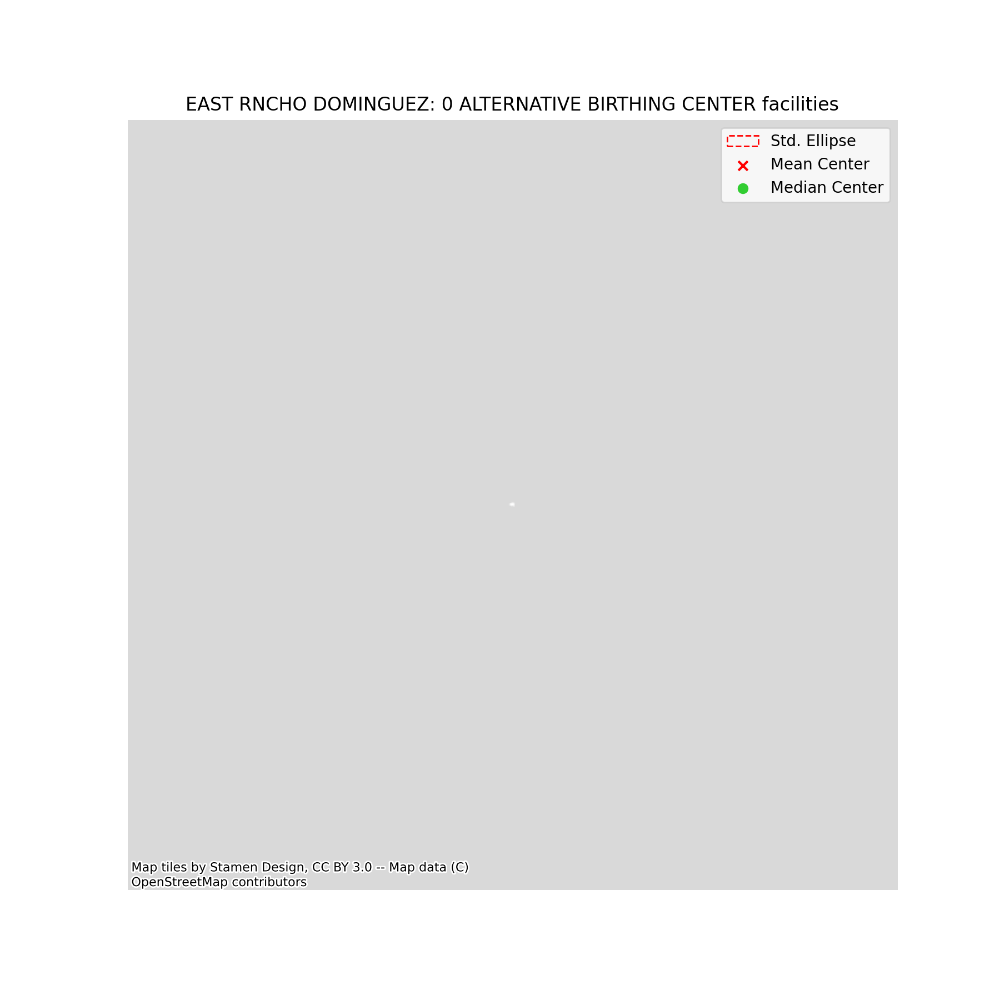

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


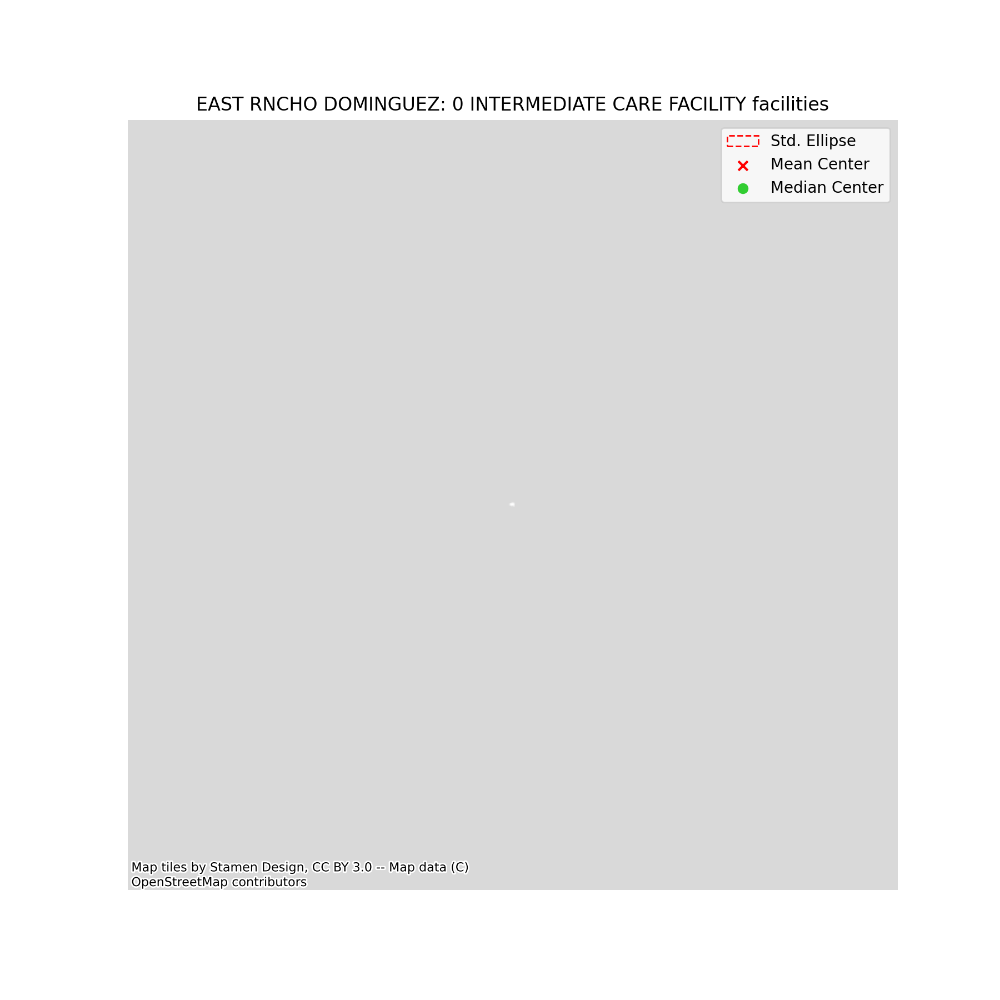

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


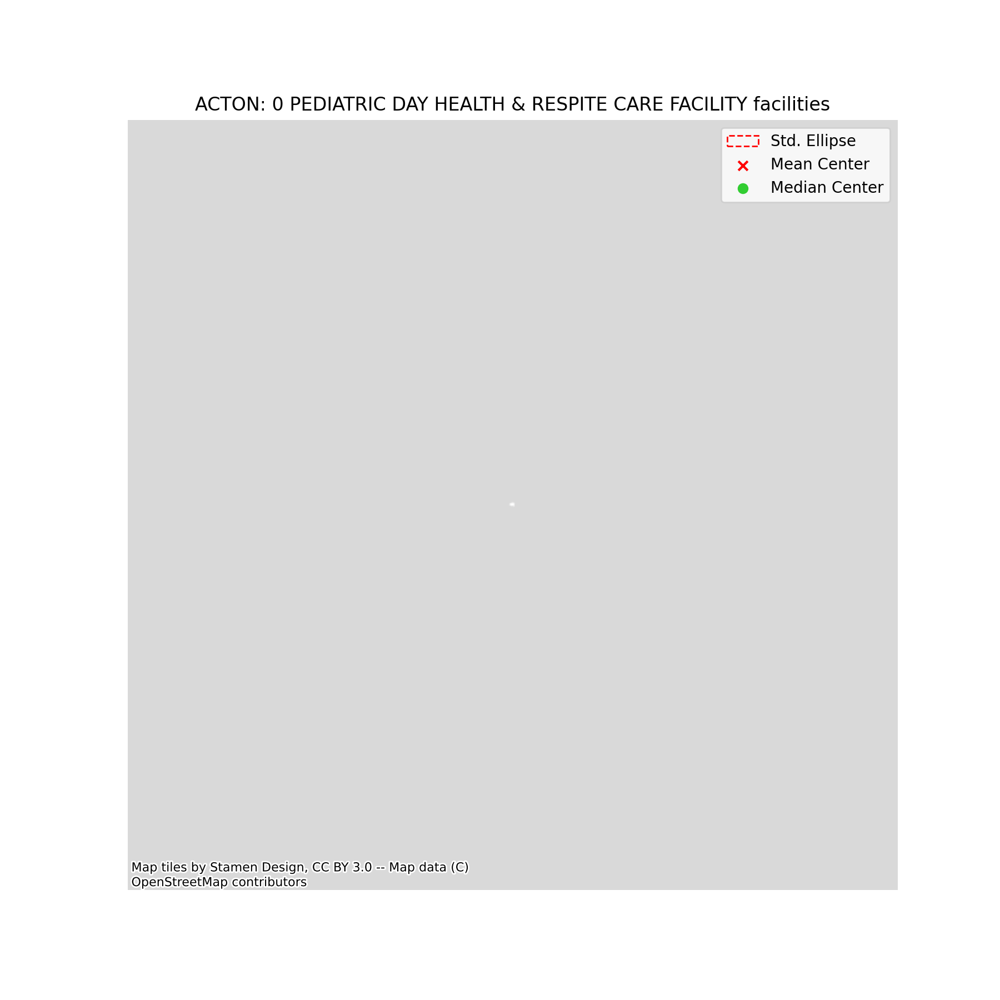

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


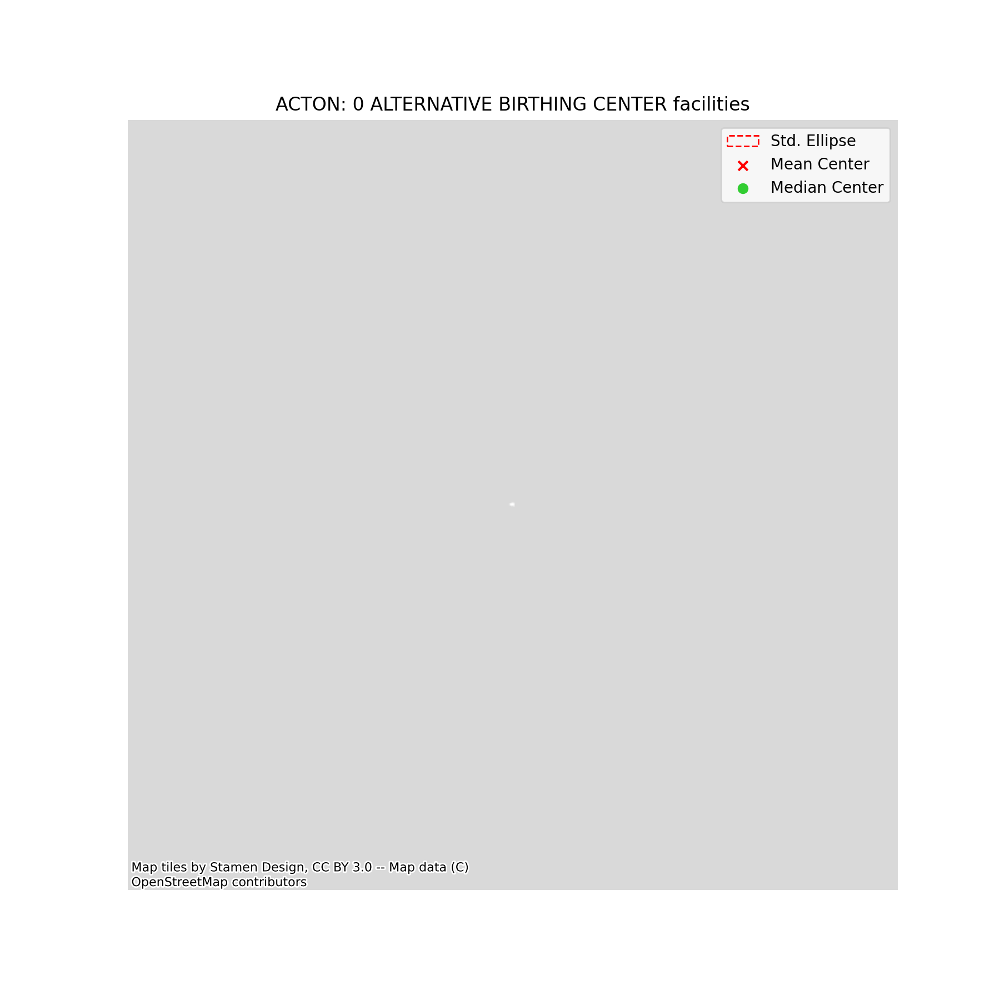

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


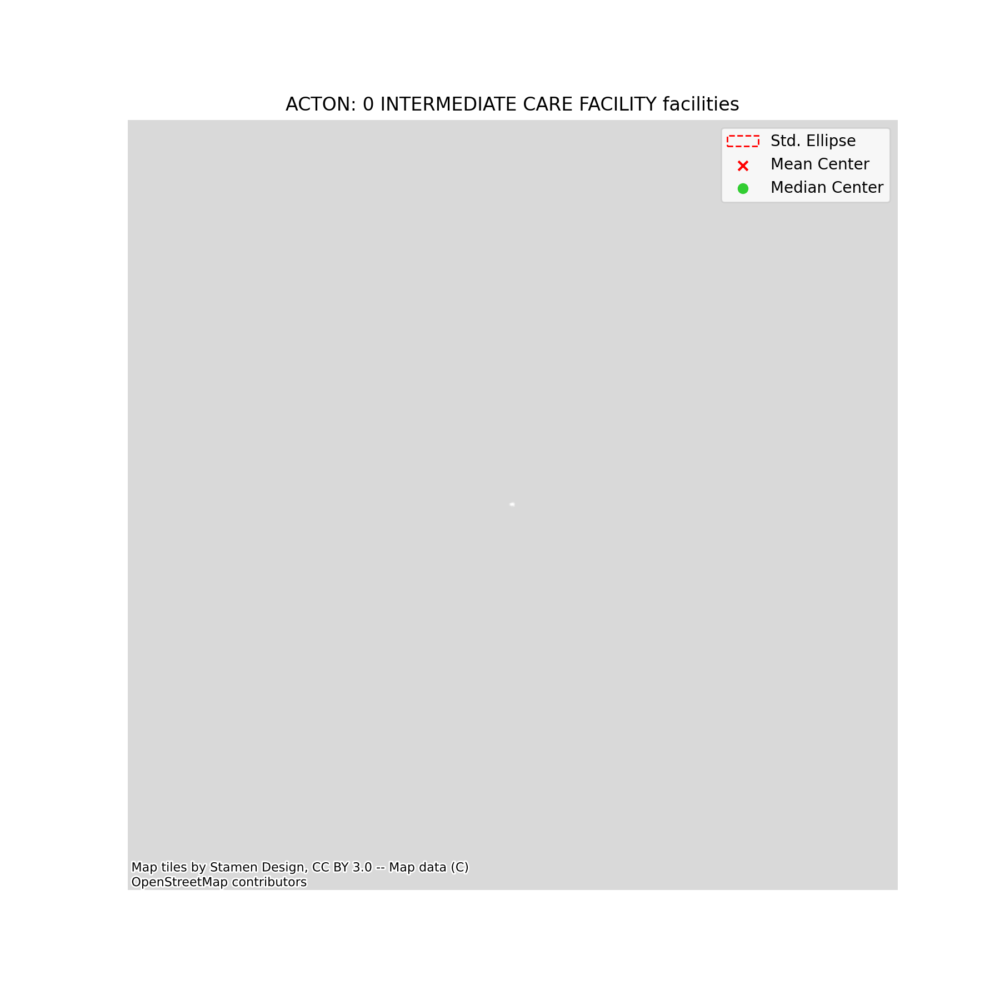

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


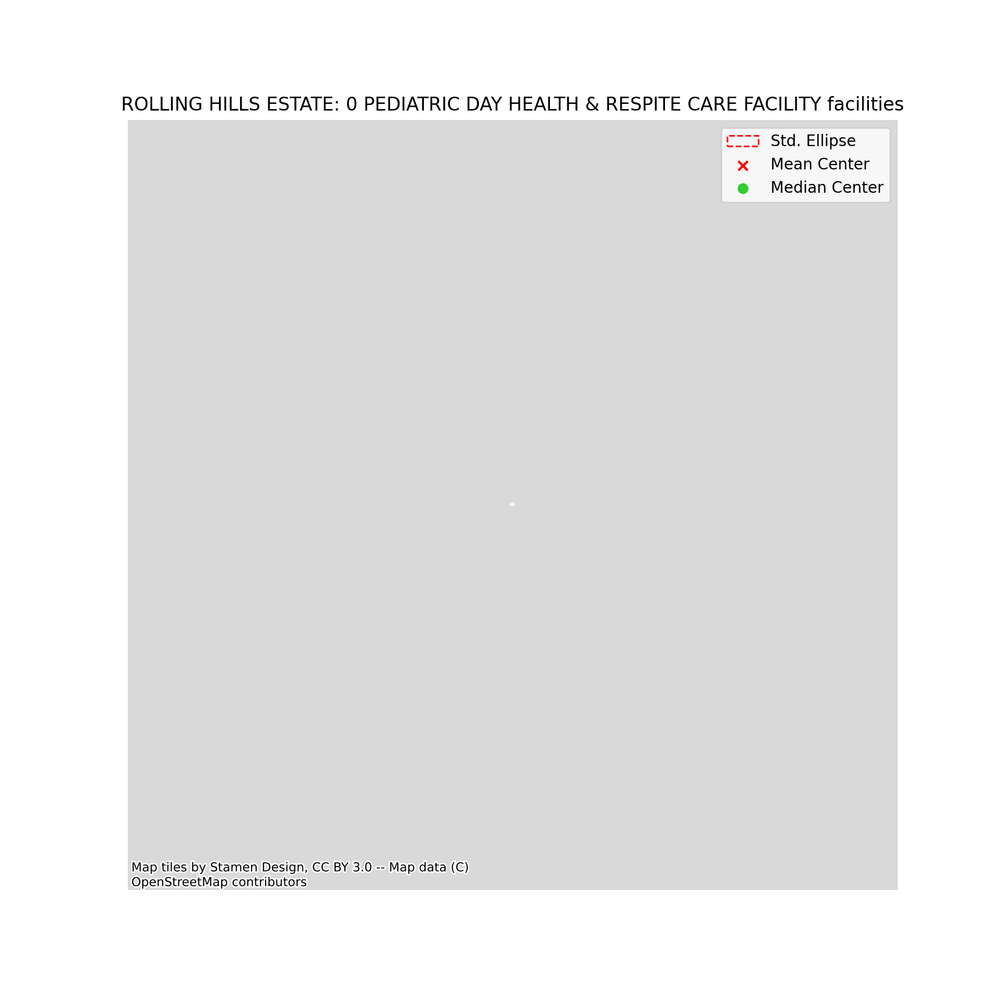

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


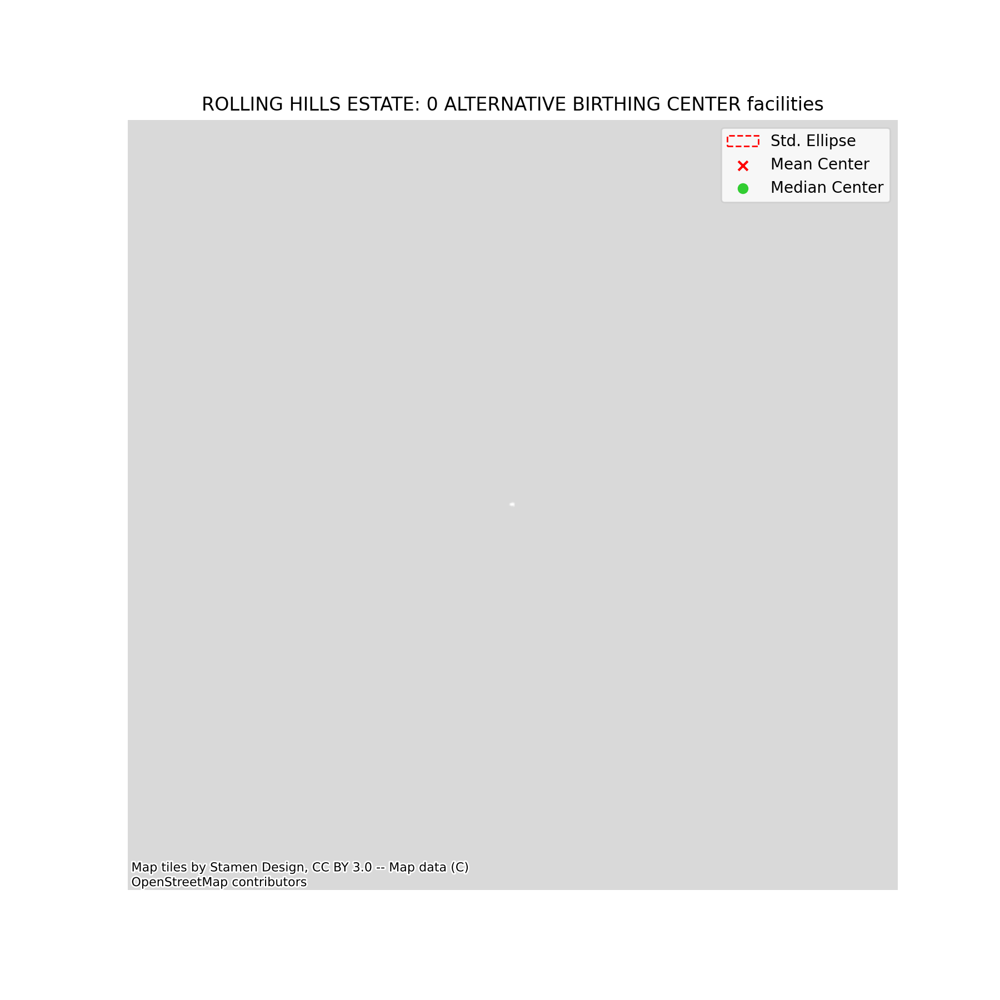

[nan nan]
[nan nan]


<IPython.core.display.Javascript object>


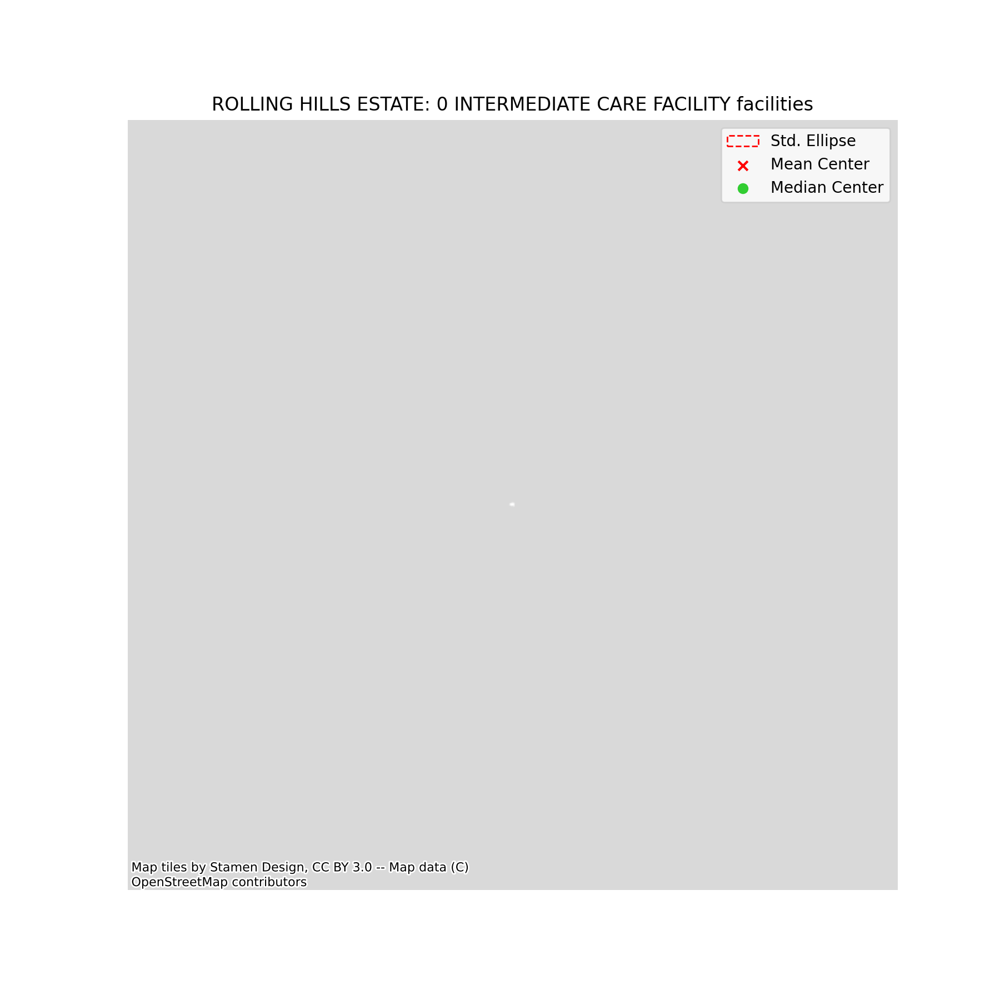

[nan nan]
[nan nan]


In [16]:
for City in bottom5areas:
    for Type_of_Care in bottom3hc:
        acc(City = City, Type_of_Care = Type_of_Care)

<div class="alert-info"> <h1> Chloropleth Map of Income in Los Angeles county </div>

In [17]:
income = gpd.read_file('income.geojson')

In [18]:
pd.set_option('display.max_columns', None)
pd.set_option('display.max_rows', None)

In [19]:
income = income.drop([0])

In [20]:
columns_to_keep = ['geoid',
 'name','B19013001', 'geometry']

In [21]:
income = income[columns_to_keep]

In [22]:
income.columns = ['geoid',
 'name',
 'Median Household Income',
 'geometry']

In [23]:
income_gdt = income.sort_values(by='Median Household Income', ascending = False)

In [24]:
income_gdt.head(302).plot(figsize=(10,10),column='Median Household Income',legend=True, cmap='BuPu', label='Median Household income in US dollar')
plt.title('Median Household income distributed by zip code in LA county in 2019')
plt.savefig("income.jpg")

/opt/conda/lib/python3.8/site-packages/geopandas/plotting.py:658: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(figsize=figsize)


<IPython.core.display.Javascript object>

<div class="alert-info"> <h1> Open Streets Map comparison of two different neighborhoods in Los Angeles county </div>

In [25]:
address = '90048, CA'
tags = {'building':True}
dist = 3500
address2 = '90021, CA'
tags2 = {'building':True}
dist2 = 3500 

In [26]:
osm = ox.geometries_from_address(address,
                                 tags=tags,
                                 dist=dist)

In [27]:
osm.head(10)

,unique_id,osmid,element_type,amenity,geometry,addr:state,building,ele,gnis:county_name,gnis:feature_id,gnis:import_uuid,gnis:reviewed,name,source,tourism,addr:housename,addr:housenumber,addr:postcode,addr:street,addr:city,email,payment:bitcoin,phone,website,access,maxheight,parking,brand,brand:wikidata,brand:wikipedia,level,shop,opening_hours,operator,nodes,building:units,height,lacounty:ain,lacounty:bld_id,start_date,building:levels,wikidata,emergency,historic,office,building:use,cuisine,drive_through,ref,takeaway,url,type,wheelchair,designation,addr:country,air_conditioning,bar,fax,internet_access,smoking,stars,old_name,denomination,religion,name:he,layer,alt_name,contact:facebook,contact:google_plus,contact:phone,contact:pinterest,contact:twitter,contact:website,note,services,building:start_date,official_name,roof:shape,wikipedia,was:tourism,source:addr,heritage,name_1,fee,building:part,service_hours,building:min_level,rooms,fixme,second_hand,service:vehicle:car_repair,service:vehicle:new_car_sales,service:vehicle:service,service:vehicle:used_car_sales,gnis:county_id,gnis:created,gnis:state_id,leisure,social_facility,social_facility:for,internet_access:fee,sport,atm,gay,lgbtq,description,architect,name:zh,surface,building:flats,screen,man_made,power,ref:US:EPA,substation,voltage,dispensing,healthcare,short_name,addr:suburb,clothes,delivery,theatre:genre,landuse,name:en,outdoor_seating,drink:beer,drink:coffee,drink:juice,addr:unit,diet:kosher,drink:espresso,ice_cream,name:ru,building:colour,was:amenity,product,heritage:operator,ref:nrhp,phone:mnemonic,ref:cvs,full_name,ref:ihop,club,studio,operator:type,railway,beauty,unisex,indoor,ways,gnis:ele
0,node/368166516,368166516,node,NaN,POINT (-118.38230 34.08251),CA,yes,58,Los Angeles,1693241,57871b70-0100-4405-bb30-88b2e001a944,no,Pacific Design Center,USGS Geonames,yes,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,node/368167082,368167082,node,NaN,POINT (-118.37972 34.07583),CA,yes,50,Los Angeles,2104476,57871b70-0100-4405-bb30-88b2e001a944,no,S Mark Taper Foundation Imaging Center,USGS Geonames,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,node/368171117,368171117,node,NaN,POINT (-118.38369 34.08168),CA,public,57,Los Angeles,1878167,57871b70-0100-4405-bb30-88b2e001a944,no,West Hollywood County Building,USGS Geonames,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
3,node/368172698,368172698,node,NaN,POINT (-118.37619 34.04640),CA,yes,32,Los Angeles,1693232,57871b70-0100-4405-bb30-88b2e001a9

In [28]:
osm2 = ox.geometries_from_address(address2,
                                 tags=tags2,
                                 dist=dist2)

In [29]:
osm2.head(5)

,unique_id,osmid,element_type,addr:state,building,ele,gnis:county_name,gnis:feature_id,gnis:import_uuid,gnis:reviewed,name,source,geometry,wikidata,wheelchair,addr:housenumber,addr:postcode,addr:street,access,amenity,fee,parking,public_transport,office,shop,description,highway,tourism,addr:city,addr:country,level,surface,fixme,brand,brand:wikidata,brand:wikipedia,cuisine,official_name,takeaway,nodes,alt_name,building:levels,building:use,height,lacounty:ain,lacounty:bld_id,name:ru,name:uk,start_date,website,wikipedia,building:part,building:units,building:colour,building:material,min_height,roof:material,roof:shape,addr:housename,name:es,name:fr,name_1,short_name,addr:street_direction_prefix,gnis:county_id,gnis:created,gnis:state_id,heritage,heritage:operator,heritage:website,historic,image,operator,ref:nrhp,source_ref,wikimedia_commons,drive_through,denomination,phone,religion,place,layer,emergency,operator:wikidata,operator:wikipedia,landuse,man_made,product,toilets:disposal,HEIGHT,delivery,opening_hours,bridge,addr:unit,healthcare,urgent_care,note,power,ref:US:EPA,substation,voltage,social_facility,contact:email,contact:facebook,contact:linkedin,contact:phone,contact:twitter,contact:website,contact:youtube,smoking,social_facility:for,tower:construction,tower:type,internet_access,agency,old_name,was:amenity,shelter_type,addr:full,second_hand,service:vehicle:car_parts,service:vehicle:car_repair,service:vehicle:new_car_sales,service:vehicle:used_car_sales,capacity:disabled,leisure,operator:type,craft,internet_access:fee,stars,atm,was:shop,supervised,rooms,type,name:en,sport,email,ref,telecom,historic:name,bus,fax,healthcare:speciality,public,dispensing,generator:method,generator:output:electricity,generator:source,generator:type,government,area,comment,source:height,bench,lit,check_date,service:vehicle:oil_change,architect,proposed:building,residential,name:zh,building:levels:underground,ways,url,building:height,capacity,theatre:genre,building_1
0,node/368167018,368167018,node,CA,yes,100,Los Angeles,1878583,57871b70-0100-4405-bb30-88b2e001a944,no,Soto Street Branch All Nations Neighborhood Ce...,USGS Geonames,POINT (-118.20896 34.04529),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
1,node/368167023,368167023,node,CA,yes,79,Los Angeles,1877986,57871b70-0100-4405-bb30-88b2e001a944,no,Catholic Charities Center,USGS Geonames,POINT (-118.27035 34.04946),NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
2,node/368172745,368172745,node,CA,yes,79,Los Angeles,1682216,57871b70-0100-4405-bb30-88b2e001a944,no,Los Angeles Stock Exchange Building,USGS Geonames,POINT (-118.25146 34.04557),Q30624966,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN

In [30]:
columns_to_keep = ['geometry','building', 'amenity']
osm = osm[columns_to_keep]
osm.sample(10)

,geometry,building,amenity
36715,"POLYGON ((-118.36001 34.07680, -118.36001 34.0...",apartments,NaN
31778,"POLYGON ((-118.35308 34.08208, -118.35308 34.0...",residential,NaN
53653,"POLYGON ((-118.35551 34.05310, -118.35553 34.0...",house,NaN
28952,"POLYGON ((-118.40095 34.05083, -118.40100 34.0...",house,NaN
26003,"POLYGON ((-118.34537 34.09188, -118.34537 34.0...",apartments,NaN
35985,"POLYGON ((-118.36393 34.08709, -118.36393 34.0...",warehouse,NaN
47169,"POLYGON ((-118.35801 34.04161, -118.35803 34.0...",residential,NaN
11556,"POLYGON ((-118.38814 34.08444, -118.38819 34.0...",house,NaN
8157,"POLYGON ((-118.40714 34.07781, -118.40721 34.0...",house,NaN
47432,"POLYGON ((-118.34341 34.03889, -118.34337 34.0...",house,NaN


In [31]:
osm.building.value_counts()

house                38892
residential          13493
apartments            9191
yes                   2686
retail                2215
commercial            1841
detached               571
garage                 519
industrial             292
garages                208
hotel                  165
school                 160
shed                   117
warehouse               59
hospital                28
parking                 25
roof                    21
museum                   9
office                   6
kindergarten             3
factory                  2
synagogue                2
civic                    2
farm_auxiliary           2
public                   2
greenhouse               1
no                       1
church                   1
bridge                   1
residential;house        1
Name: building, dtype: int64

In [32]:
osm.loc[osm['building']=='house','building'] = 'other facility'
osm.loc[osm['building']=='residential;house','building'] = 'other facility'
osm.loc[osm['building']=='yes','building'] = 'other facility'
osm.loc[osm['building']=='hotel','building'] = 'other facility'
osm.loc[osm['building']=='residential','building'] = 'other facility'
osm.loc[osm['building']=='apartments','building'] = 'other facility'
osm.loc[osm['building']=='residential','building'] = 'other facility'
osm.loc[osm['building']=='detached','building'] = 'other facility'


osm.loc[osm['building']=='garage','building'] = 'other facility'
osm.loc[osm['building']=='roof','building'] = 'other facility'
osm.loc[osm['building']=='garages','building'] = 'other facility'
osm.loc[osm['building']=='parking','building'] = 'other facility'
osm.loc[osm['building']=='parking','building'] = 'other facility'
osm.loc[osm['building']=='synagogue','building'] = 'other facility'
osm.loc[osm['building']=='church','building'] = 'other facility'
osm.loc[osm['building']=='shed','building'] = 'other facility'
osm.loc[osm['building']=='greenhouse','building'] = 'other facility'
osm.loc[osm['building']=='no','building'] = 'other facility'
osm.loc[osm['building']=='civic','building'] = 'other facility'
osm.loc[osm['building']=='public','building'] = 'other facility'
osm.loc[osm['building']=='bridge','building'] = 'other facility'
osm.loc[osm['building']=='grandstand','building'] = 'other facility'
osm.loc[osm['building']=='college','building'] = 'other facility'
osm.loc[osm['building']=='school','building'] = 'other facility'
osm.loc[osm['building']=='kindergarten','building'] = 'other facility'
osm.loc[osm['building']=='museum','building'] = 'other facility'


osm.loc[osm['building']=='industrial','building'] = 'other facility'
osm.loc[osm['building']=='retail','building'] = 'other facility'
osm.loc[osm['building']=='office','building'] = 'other facility'
osm.loc[osm['building']=='factory','building'] = 'other facility'
osm.loc[osm['building']=='construction','building'] = 'other facility'
osm.loc[osm['building']=='warehouse','building'] = 'other facility'
osm.loc[osm['building']=='farm_auxiliary','building'] = 'other facility'




osm.loc[osm['building']=='commercial','building'] = 'other facility'




In [33]:
osm.building.value_counts()

other facility    70488
hospital             28
Name: building, dtype: int64

In [34]:
osm2.loc[osm2['building']=='house','building'] = 'other facility'
osm2.loc[osm2['building']=='yes','building'] = 'other facility'
osm2.loc[osm2['building']=='hotel','building'] = 'other facility'
osm2.loc[osm2['building']=='residential','building'] = 'other facility'
osm2.loc[osm2['building']=='apartments','building'] = 'other facility'
osm2.loc[osm2['building']=='residential','building'] = 'other facility'
osm2.loc[osm2['building']=='school','building'] = 'other facility'
osm2.loc[osm2['building']=='kindergarten','building'] = 'other facility'
osm2.loc[osm2['building']=='college','building'] = 'other facility'
osm2.loc[osm2['building']=='warehouse','building'] = 'other facility'
osm2.loc[osm2['building']=='factory','building'] = 'other facility'
osm2.loc[osm2['building']=='retail','building'] = 'other facility'
osm2.loc[osm2['building']=='commercial','building'] = 'other facility'
osm2.loc[osm2['building']=='industrial','building'] = 'other facility'
osm2.loc[osm2['building']=='roof','building'] = 'other facility'
osm2.loc[osm2['building']=='garage','building'] = 'other facility'
osm2.loc[osm2['building']=='parking','building'] = 'other facility'
osm2.loc[osm2['building']=='shed','building'] = 'other facility'
osm2.loc[osm2['building']=='office','building'] = 'other facility'
osm2.loc[osm2['building']=='garages','building'] = 'other facility'
osm2.loc[osm2['building']=='tower','building'] = 'other facility'
osm2.loc[osm2['building']=='farm_auxiliary','building'] = 'other facility'
osm2.loc[osm2['building']=='university','building'] = 'other facility'
osm2.loc[osm2['building']=='construction','building'] = 'other facility'
osm2.loc[osm2['building']=='civic','building'] = 'other facility'
osm2.loc[osm2['building']=='church','building'] = 'other facility'
osm2.loc[osm2['building']=='transportation','building'] = 'other facility'
osm2.loc[osm2['building']=='vacant','building'] = 'other facility'
osm2.loc[osm2['building']=='bridge','building'] = 'other facility'
osm2.loc[osm2['building']=='fire_station','building'] = 'other facility'
osm2.loc[osm2['building']=='proposed','building'] = 'other facility'
osm2.loc[osm2['building']=='stadium','building'] = 'other facility'
osm2.loc[osm2['building']=='detached','building'] = 'other facility'
osm2.loc[osm2['building']=='greenhouse','building'] = 'other facility'
osm2.loc[osm2['building']=='train_station','building'] = 'other facility'
osm2.loc[osm2['building']=='cathedral','building'] = 'other facility'
osm2.loc[osm2['building']=='apartmenta','building'] = 'other facility'
osm2.loc[osm2['building']=='public','building'] = 'other facility'
osm2.loc[osm2['building']=='library','building'] = 'other facility'

In [35]:
osm2.building.value_counts()

other facility    38447
hospital             49
Name: building, dtype: int64

In [36]:
fig, ax = plt.subplots(1, 2, figsize=(20, 20))

osm.plot(ax =ax[0], figsize=(20,20), column='building',
         cmap='plasma',
         legend=True)

ax[0].axis("off")
ax[0].set_title("Open Street Map - 90048 (Median Household Income: $100,586)")

osm2.plot(ax =ax[1], figsize=(20,20), column='building',
         cmap='plasma',
         legend=True)
ax[1].axis("off")
ax[1].set_title("Open Street Map - 90021 (Median Household Income: $21,365)")

<ipython-input-36-894bf82ae680>:1: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`).
  fig, ax = plt.subplots(1, 2, figsize=(20, 20))


<IPython.core.display.Javascript object>

Text(0.5, 1.0, 'Open Street Map - 90021 (Median Household Income: $21,365)')

<div class="alert-info"> <h1> Time Chart of the Medicare and Medical enrollment in Los Angeles county </div>

In [7]:
time_data = pd.read_csv('timedata1.csv')

In [8]:
time_data = time_data['PARTICIPATION_DATE'].value_counts().reset_index()
time_data

,index,PARTICIPATION_DATE
0,2019.0,262
1,2018.0,195
2,2016.0,159
3,2017.0,152
4,2020.0,146
5,2014.0,139
6,2015.0,132
7,2012.0,112
8,2013.0,107
9,2009.0,98


In [9]:
time_data = time_data.rename(columns={'index':'year','PARTICIPATION_DATE':'count'})

In [10]:
time_data = time_data.sort_values(by='year')

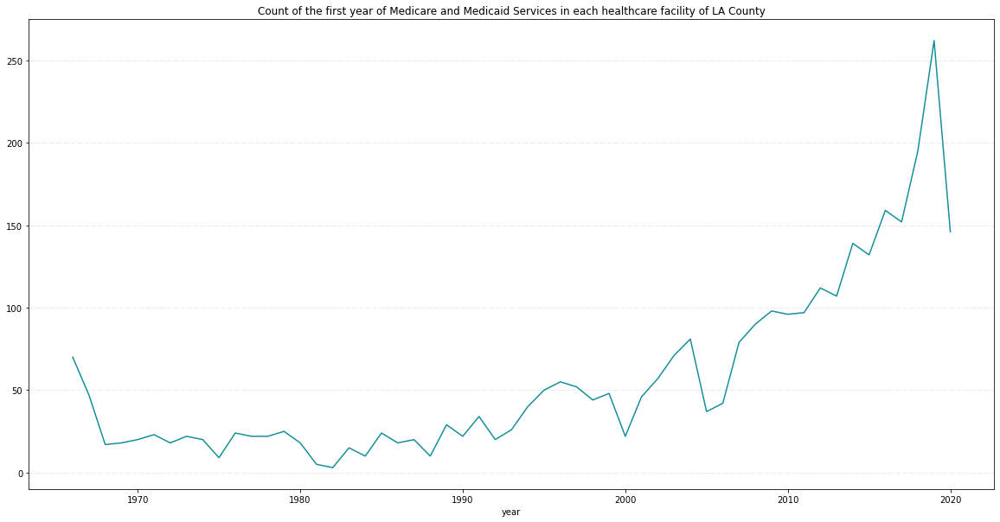

In [11]:
time_data.plot(figsize=(20,10), x='year', title='Count of the first year of Medicare and Medicaid Services in each healthcare facility of LA County', color='#148e99')
plt.legend().remove()
plt.grid(color='#b9c9c9', linestyle='-.', linewidth=0.75, axis='y', alpha=0.5)
plt.savefig("enrollment.jpg")